# Utilities Functions

## Import

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import sys
import math
import bisect
import random
import csv
import numpy as np
from datetime import datetime
from collections import defaultdict
import datetime
import csv
from scipy.io import loadmat
from scipy.spatial.distance import squareform
import scipy.cluster.hierarchy as hclust
import matplotlib.pyplot as plt
import gzip
import pickle
import copy
import warnings
import pandas as pd
import torch
from scipy.stats import ks_2samp
import scipy
import seaborn
from mpl_toolkits.mplot3d import Axes3D
from numpy import genfromtxt
import matplotlib.transforms as mtransforms
from matplotlib.gridspec import GridSpec
import matplotlib.ticker as ticker
from tqdm import tqdm

from sklearn.linear_model import LinearRegression, Ridge
from sklearn.decomposition import PCA, KernelPCA, TruncatedSVD
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.ensemble import BaggingRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from scipy.interpolate import UnivariateSpline
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.gaussian_process.kernels import RBF
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.manifold import TSNE
from sklearn.manifold import Isomap
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import roc_auc_score, cohen_kappa_score, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from scipy.stats import gaussian_kde

import scipy.stats as stats

import geopandas as gpd

In [ ]:
! pip install adjustText

from adjustText import adjust_text

# Result Plots

## Function

In [ ]:
# @title Help Function
def load_all(filename):
    with gzip.open(filename, "rb") as f:
        data = pickle.load(f)
    return data

def deal_str_date(str_date):
    real_start_date = '2020-01-01'
    start = datetime.datetime(int(real_start_date.split('-')[0]), int(real_start_date.split('-')[1]),
                              int(real_start_date.split('-')[2]))
    days = (datetime.datetime(int(str_date.split('-')[0]), int(str_date.split('-')[1]),
                              int(str_date.split('-')[2])) - start).days
    return days

def trans_date(days_elapsed):
    start_date = datetime.datetime(2020, 1, 1)
    target_date = start_date + datetime.timedelta(days=days_elapsed)
    return target_date.strftime('%Y-%m-%d')

def trans_date2(days_elapsed):
    start_date = datetime.datetime(2020, 1, 1)
    target_date = start_date + datetime.timedelta(days=days_elapsed)
    return target_date.strftime('%Y\n%m-%d')

def find_keys_with_special_prefix(d, prefix):
        return [key for key in d if key.startswith(prefix) and
            (key == prefix or key[len(prefix):].startswith('.'))]

def remove_isolated_points(arr, threshold=4, window=3):
    if len(arr) <= 3:
        return []
    # Create a boolean mask for NaNs
    nan_mask = np.isnan(arr[:, -1])
    # Create a copy of the array for modifications
    arr_mod = arr.copy()
    arr_ind = np.arange(0, len(arr))

    for i in range(0, len(arr)):
        window_mask = nan_mask[max(0, i - window): min(len(arr), i + window + 1)]
        if arr_mod[i, -1] and np.sum(window_mask) / (len(window_mask) - 1) >= threshold / (window * 2):
            arr_mod[i, -1] = np.nan

    # Remove NaNs at the start and end
    while np.isnan(arr_mod[0, -1]):
        arr_mod = arr_mod[1:]
        arr_ind = arr_ind[1:]
    while np.isnan(arr_mod[-1, -1]):
        arr_mod = arr_mod[:-1]
        arr_ind = arr_ind[:-1]

    return arr_ind


def count_local_extrema(array):
    # Calculate the difference between consecutive elements
    diff = np.diff(array)
    # Calculate the sign of the difference
    signs = np.sign(diff)
    # Calculate the difference between consecutive signs
    sign_diff = np.diff(signs)

    # Local maxima occur where the sign changes from positive to negative, so the difference is -2
    local_maxima = np.sum(sign_diff == -2)
    # Local minima occur where the sign changes from negative to positive, so the difference is 2
    local_minima = np.sum(sign_diff == 2)

    return local_maxima + local_minima

In [ ]:
# @title load_label_smooth2
def load_label_smooth2(path, country, s=30, k=4, output_noise_level=False):
    file_path = os.path.join(path, 'freqs_final_' + country + '.csv')

    df = pd.read_csv(file_path)

    # Find start date
    start_date = df['CollectionDate'].min()
    print(start_date)

    real_start_date = '2020-01-01'
    start = datetime.datetime(int(real_start_date.split('-')[0]), int(real_start_date.split('-')[1]),
                              int(real_start_date.split('-')[2]))

    def deal_str_date(str_date, start=start):
        days = (datetime.datetime(int(str_date.split('-')[0]), int(str_date.split('-')[1]),
                                  int(str_date.split('-')[2])) - start).days
        return days

    # Sort the data by 'Pango', 'AccessDate', 'CollectionDate'
    df_sort = df.sort_values(['Pango', 'CollectionDate'])[
        ['Pango', 'CollectionDate', 'totalSeqs', 'VarSeqs', 'VarFreq']]

    # Change date to abosulte value
    df_sort['CollectionDay'] = df_sort['CollectionDate'].apply(deal_str_date)

    df_sort = df_sort[['Pango', 'CollectionDate', 'CollectionDay', 'totalSeqs', 'VarSeqs', 'VarFreq']]

    # Generate a dictionary with 'Pango' as keys and all other columns as values
    raw_dict = {}
    original_dict = {}
    log_dict = {}
    interpolated_dict = {}
    mask_dict = {}
    smoothed_dict = {}

    noise_level = []
    noise_ind = []
    noise_ind2 = []

    missing_list = set()
    remove_list = set()
    num_less = 0
    for pango, group in df_sort.groupby('Pango'):
        data = group.values.tolist()

        data = [x[2:] for x in data]

        prev_date = None
        new_data = []
        raw = []

        for i, sublist in enumerate(data):
            date = sublist[0]

            if prev_date is not None and date > prev_date + 1:
                missing_list.add(pango)
                gap = date - prev_date - 1
                new_lol = []
                for i in range(prev_date + 1, date):
                    new_list = [i] + [np.nan] * (len(sublist) - 1)
                    new_lol.append(new_list)
                new_data += new_lol

            new_data.append(sublist)
            prev_date = date

            raw.append(sublist)

        original_data = np.array(new_data)
        raw_data = np.array(raw)

        try:
            pango_ind = remove_isolated_points(original_data, threshold=4, window=3)
        except:
            remove_list.add(pango)
            continue
        if not len(pango_ind):
            remove_list.add(pango)
            continue
        original_data = original_data[pango_ind[0]:pango_ind[-1] + 1]

        while raw_data[0, 0] < original_data[0, 0]:
            raw_data = raw_data[1:]
        while raw_data[-1, 0] > original_data[-1, 0]:
            raw_data = raw_data[:-1]

        pango_data = original_data.copy()
        pango_data[:, 1:] = np.log10(original_data[:, 1:])

        interpolated_pango = pango_data.copy()
        interpolated_mask = np.full(pango_data.shape[0], True)
        smoothed_pango = pango_data.copy()

        less_data = False
        for i in range(1, 4):
            mask = ~np.isnan(pango_data[:, i])

            if np.sum(mask) <= 1:
                less_data = True
                num_less += 1
                break

            interpolated_data = pd.Series(pango_data[:, i]).interpolate(method='linear').to_numpy().squeeze()

            rules = (pango in ['BA.1.1']) and country == 'USA'
            with warnings.catch_warnings():
                warnings.simplefilter("ignore", category=UserWarning)
                spoint = 3
                spline = UnivariateSpline(pango_data[:, 0], interpolated_data, s=spoint, k=np.amin(
                    [np.sum(mask) - 1, k]))  # s is the smoothing factor (0.1,4) (0.09,4) (0.085,4) (0.0625,5)
                if not rules:
                    while count_local_extrema(spline(pango_data[:, 0])) > 5:
                        spoint += 8
                        spline = UnivariateSpline(pango_data[:, 0], interpolated_data, s=spoint,
                                                  k=np.amin([np.sum(mask) - 1, k]))
                else:
                    while count_local_extrema(spline(pango_data[:, 0])) > 4:
                        spoint += 1
                        spline = UnivariateSpline(pango_data[:, 0], interpolated_data, s=spoint,
                                                  k=np.amin([np.sum(mask) - 1, 2]))
            smoothed_y = spline(pango_data[:, 0])  # np.maximum(spline(pango_data[:,0]), 0)

            interpolated_pango[:, i] = interpolated_data
            if i > 1:
                assert (np.logical_and(interpolated_mask, mask) == interpolated_mask).all()
            else:
                interpolated_mask = np.logical_and(interpolated_mask, mask)
            smoothed_pango[:, i] = smoothed_y

            if i == 3:
                noise_level.append(np.abs(pango_data[mask][:, 3] - smoothed_y[mask]))
                noise_ind.append(pango_data[mask][:, 0])
                noise_ind2.append(pango_data[mask][:, 3])

        if less_data:
            continue

        raw_dict[country + '_' + pango] = raw_data
        original_dict[country + '_' + pango] = original_data
        log_dict[country + '_' + pango] = pango_data
        interpolated_dict[country + '_' + pango] = interpolated_pango
        mask_dict[country + '_' + pango] = interpolated_mask
        smoothed_dict[country + '_' + pango] = smoothed_pango

    print(country, f' Label Has {int(len(missing_list))} Missing')
    print(num_less)
    print(country, f' {int(len(remove_list))} Removed')
    print(len(raw_dict))

    noise_level = np.concatenate(noise_level, axis=0)
    noise_ind = np.concatenate(noise_ind, axis=0)
    noise_ind2 = np.concatenate(noise_ind2, axis=0)

    if output_noise_level:
        return start_date, raw_dict, original_dict, log_dict, interpolated_dict, mask_dict, smoothed_dict, df_sort, noise_level, noise_ind, noise_ind2

    return start_date, raw_dict, original_dict, log_dict, interpolated_dict, mask_dict, smoothed_dict, df_sort

In [ ]:
# @title process_dataset
def process_dataset(sample_datasets, sample_x_values, log=False):
    def softmax(x):
        """Compute the softmax of vector x."""
        exp_x = np.power(10, x)  # for numerical stability
        return exp_x / exp_x.sum(axis=0, keepdims=True)

    result = copy.deepcopy(sample_datasets)

    all_y_sample = {}
    for name, y in sample_datasets.items():
        for xi, yi in zip(sample_x_values[name], y):
            if xi not in all_y_sample:
                all_y_sample[xi] = []
            all_y_sample[xi].append(yi)

    # Compute softmax for each x position
    for xi, ys in all_y_sample.items():
        all_y_sample[xi] = softmax(np.array(ys))

    # Convert numpy arrays to lists for easy manipulation
    for xi in all_y_sample.keys():
        all_y_sample[xi] = list(all_y_sample[xi])

    # Update the sample datasets with softmaxed values
    for name in sample_datasets.keys():
        for i, xi in enumerate(sample_x_values[name]):
            if xi in all_y_sample and len(all_y_sample[xi]) > 0:
                if not log:
                    result[name][i] = all_y_sample[xi].pop(0)
                else:
                    result[name][i] = np.log10(all_y_sample[xi].pop(0))

    return result

In [ ]:
# @title trans_dict
def trans_dict(original, lineage_dict, ground=True, log=True, resort=True, print_other=False, split_date = '2022-12-31'):
    transed = {}
    transed_x = {}
    colors_dict = {}

    other_list = []

    split = deal_str_date(split_date)

    for k, v in lineage_dict.items():
        colors_dict[k] = v[1]

        y = []
        x = []

        for l in v[0]:
            if l in original.keys():
                data = original[l]
                if ground:
                    if log:
                        y.append(np.log10(data[:, -1]))
                    else:
                        y.append(data[:, -1])
                    x.append(data[:, 0])
                else:
                    y.append(data[1])
                    x.append(data[0])

            if k == 'Other' and x and np.nanmax(x[-1])>split:
                mask = x[-1] >= split
                if ground:
                  if log:
                    other_list.append([k,l,np.nanmax(np.log10(data[:, -1][mask])),np.nanmax(x[-1])])
                  else:
                    other_list.append([k,l,np.nanmax(data[:, -1][mask]),np.nanmax(x[-1])])
                else:
                  other_list.append([k,l,np.nanmax(data[1][mask]),np.nanmax(x[-1])])

        if x and y:
            result_dict = {}
            for idx, vals in zip(x, y):
                for i, v in zip(idx, vals):
                    if i in result_dict:
                        result_dict[i] = np.log10(np.power(10, result_dict[i]) + np.power(10, v))
                    else:
                        result_dict[i] = v

            # Convert dictionary back to arrays if needed
            index_array = np.array(list(result_dict.keys()))
            value_array = np.array(list(result_dict.values()))

            if resort:
              sorted_indices = np.argsort(index_array)
              index_array = index_array[sorted_indices]
              value_array = value_array[sorted_indices]

            transed[k] = value_array
            transed_x[k] = index_array

    other_list = sorted(other_list, key=lambda x: x[-2], reverse=True)
    if print_other:
        print(other_list)

        # l1, l2 = [], []
        # for o in other_list:
        #   if o[-2] >=-1.5:
        #     l1.append(o[1])
        #   elif o[-2] >=-2:
        #     l2.append(o[1])
        # print(len(l1), l1)
        # print(len(l2), l2)

    return transed, transed_x, colors_dict

In [ ]:
# @title import_cluster
def import_cluster():
  import importlib
  import clusters_dict
  import clusters_dict_future


  importlib.reload(clusters_dict)
  importlib.reload(clusters_dict_future)
  from clusters_dict import clusters
  from clusters_dict_future import clusters_future

  return clusters, clusters_future

In [ ]:
# @title summary_lineage
def summary_lineage(true_dict_list, country, find=False, future=False):
    unique_keys = set()
    for d in true_dict_list:
        unique_keys.update(d.keys())
    unique_keys = [n for n in unique_keys if country in n]

    lineage_dict = {}
    lineage_name_dict = defaultdict(list)
    used_keys = ['pango_lineages', 'display_name', 'col']
    defined_keys = []

    c, cf = import_cluster()
    if future:
      c.update(cf)
    for k, v in c.items():
        if not set(used_keys).issubset(set(v.keys())):
            continue
        pango_lineages = v['pango_lineages']
        if not pango_lineages:
          continue
        col = v['col']
        display_name = pango_lineages[0]["name"] # v['display_name']
        lineage_dict[display_name] = [[], col]

        for l in pango_lineages:
            matching_keys = find_keys_with_special_prefix(unique_keys, country + '_' + l["name"])
            if not matching_keys:
                continue
            for m in matching_keys:
              lineage_name_dict[m].append(display_name)
              defined_keys.append(m)

    for k, v in lineage_name_dict.items():
        display_name = max(v, key=lambda x: len(x))
        lineage_dict[display_name][0].append(k)

    item_counts = defaultdict(int)
    for values in lineage_dict.values():
        for l in values[0]:
            item_counts[l] += 1
    repeated_items = [item for item, count in item_counts.items() if count > 1]
    if repeated_items:
        print("Repeated items:", repeated_items)

    other_key = list(set(unique_keys) - set(defined_keys))
    new_color = ['#d0d5b9', '#b42c8e', '#09fdff', '#cf305f', '#b1d345', '#247c26', '#f60796', '#f0164d', '#c0ac37', '#2a1e77', '#e4590a', '#5f0cac', '#3ad03a']
    lineage_dict['Other'] = [other_key, new_color[-1]]

    return lineage_dict

def summary_lineage_old(true_dict_list, country, future=False):
    unique_keys = set()
    for d in true_dict_list:
        unique_keys.update(d.keys())
    unique_keys = [n for n in unique_keys if country in n]

    c, cf = import_cluster()
    if future:
      c.update(cf)
    lineage_dict = {}
    used_keys = ['pango_lineages', 'display_name', 'col']
    defined_keys = []
    for k, v in c.items():
        if not set(used_keys).issubset(set(v.keys())):
            continue
        pango_lineages = v['pango_lineages']
        if not pango_lineages:
          continue
        lineage = []
        for l in pango_lineages:
            matching_keys = find_keys_with_special_prefix(unique_keys, country + '_' + l["name"])
            if not matching_keys:
                continue
            for m in matching_keys:
              lineage.append(m)
              defined_keys.append(m)

        display_name = pango_lineages[0]["name"] # v['display_name']
        col = v['col']

        lineage_dict[display_name] = [lineage, col]

    item_counts = defaultdict(int)
    for values in lineage_dict.values():
        for l in values[0]:
            item_counts[l] += 1
    repeated_items = [item for item, count in item_counts.items() if count > 1]
    if repeated_items:
        print("Repeated items:", repeated_items)

    other_key = list(set(unique_keys) - set(defined_keys))
    new_color = ['#d0d5b9', '#b42c8e', '#09fdff', '#cf305f', '#b1d345', '#247c26', '#f60796', '#f0164d', '#c0ac37', '#2a1e77', '#e4590a', '#5f0cac', '#3ad03a']
    lineage_dict['Other'] = [other_key, new_color[-1]]

    return lineage_dict

In [ ]:
# @title bin_error
def bin_error(bin_centers, bin_edges, index, mae, num_samples=False):
    errors = []
    variances = []

    ns = []
    for i in range(len(bin_centers)):
        # print(type(index), index.shape)
        bin_mask = (index >= bin_edges[i]) & (index < bin_edges[i + 1])

        bin_errors = mae[bin_mask]
        bin_mean_error = np.nanmean(bin_errors) if bin_errors.size else np.nan
        bin_variance = np.nanvar(bin_errors) if bin_errors.size else np.nan
        errors.append(bin_mean_error)
        variances.append(bin_variance)

        ns.append(np.nansum(bin_mask))

    if num_samples:
        return errors, variances, ns

    return errors, variances


In [ ]:
# @title calculate_plot_bins
def calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, index_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, name, x_name, mask_list):

  if 'Weeks' in name:
    fig1, ax1_1 = plt.subplots(figsize=(24, 6), dpi=300)
  else:
    fig1, ax1_1 = plt.subplots(figsize=(12, 6), dpi=300)
  ax1_2 = ax1_1.twinx()
  line1 = []

  for i in range(len(name_list)):
    line_name = name_list[i]
    line_color = colors[i]
    lf = line_format[i]
    future = future_list[i]

    index = index_list[i]
    date = date_list[i]
    pred = pred_list[i]
    true = label_list[i]
    strue = slabel_list[i]
    mae = np.abs(pred - true)
    noise = np.abs(strue - true)

    exp_date = exp_date_list[i]
    exp = exp_list[i]
    # exp_new = np.full(date.shape, np.nan)
    # indices = np.isin(date, exp_date)
    # exp_new[indices] = exp[np.searchsorted(exp_date, date[indices])]
    exp_mae = np.abs(exp - true)

    if mask_list:
      m = mask_list[i]

      date = date[m]
      mae = mae[m]
      exp_mae = exp_mae[m]
      exp = exp[m]
      index = index[m]

    if split:
      time_mask = date >= split

      mae = mae[time_mask]
      exp_mae = exp_mae[time_mask]
      exp = exp[time_mask]
      index = index[time_mask]

    errors, variances =  bin_error(bin_centers, bin_edges, index, mae)
    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centers, errors, lf, label=line_name, color=line_color)
      ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.2)
      line1 += l
    else:
      l = ax1_1.plot(bin_centers[2:], errors[2:], lf, label=line_name, color=line_color)
      ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.2)
      line1 += l

      ax1_1.plot(bin_centers[:2], errors[:2], lf, color=line_color, alpha=0.2)
      ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.1)

    if 'Prediction' not in name:
      errors, variances =  bin_error(bin_centers, bin_edges, index, exp_mae)
    else:
      errors, variances =  bin_error(bin_centers, bin_edges, exp, exp_mae)

    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centers, errors, '--o', label=f'Regression_{future}D', color=line_color)
      ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt='--o',
                      color=line_color, alpha=0.2)
      line1 += l
    else:
      pass
      # l = ax1_1.plot(bin_centers[2:], errors[2:], '--o', label=f'Regression_{future}', color=line_color)
      # ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.2)
      # line1 += l

      # ax1_1.plot(bin_centers[:2], errors[:2], '--o', color=line_color, alpha=0.2)
      # ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.1)

  if 'SNR' not in name and '#Valid Data' not in name:
    # noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, noise_ind, noise_level, num_samples=True)
    index = index_list[0]
    true = label_list[0]
    strue = slabel_list[0]
    noise = np.abs(strue - true)
    noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, index, noise, num_samples=True)

    l = ax1_1.plot(bin_centers, noise_level, '--', label='Noise Level', color='k')
    line1 += l
    l = ax1_2.plot(bin_centers, num_samples, '-', label='Num Samples', color='k')
    line1 += l


  labels = [l.get_label() for l in line1]
  zipped_lists = list(zip(line1, labels))
  sorted_pairs = sorted(zipped_lists, key=lambda x: x[1])
  if '#Valid Data' not in name:
      ind = len(sorted_pairs)//2 - 1
      sorted_pairs = sorted_pairs[2+ind:] + sorted_pairs[1:2] + sorted_pairs[2:2+ind] + sorted_pairs[0:1]
  line1_sorted, labels_sorted = zip(*sorted_pairs)

  ax1_1.legend(line1_sorted, labels_sorted, fontsize = 14, ncol=2)

  # ax1_1.legend(line1, labels)
  if x_labels:
    ax1_1.set_xticks(bin_centers)
    ax1_1.set_xticklabels(x_labels)
  ax1_1.tick_params(axis='y', labelsize=14)
  ax1_1.tick_params(axis='x', labelsize=14)
  ax1_1.set_title(name[:-4], fontsize = 16)
  ax1_1.set_ylabel('MAE', fontsize = 16)
  ax1_1.set_xlabel(x_name, fontsize = 16)
  fig1.savefig(name)
  plt.show()
  plt.close()

In [ ]:
# @title norm_the_result
def norm_the_result(pred_dict_list, exp_dict_list, lineage_dict):
  transed_pred_dict_list, transed_exp_dict_list = [], []

  for i in range(len(pred_dict_list)):
    transed_pred_dict, transed_exp_dict = {}, {}

    transed, transed_x, _ = trans_dict(pred_dict_list[i], lineage_dict, ground=False, log=False, resort=False)
    transed = process_dataset(transed, transed_x, log=True)

    exp_transed, exp_transed_x, _ = trans_dict(exp_dict_list[i], lineage_dict, ground=False, log=False, resort=False)
    exp_transed = process_dataset(exp_transed, exp_transed_x, log=True)

    for k in transed.keys():
      transed_pred_dict[k] = np.stack([transed_x[k], transed[k]])
    transed_pred_dict_list.append(transed_pred_dict)

    for k in exp_transed.keys():
      transed_exp_dict[k] = np.stack([exp_transed_x[k], exp_transed[k]])
    transed_exp_dict_list.append(transed_exp_dict)

  return transed_pred_dict_list, transed_exp_dict_list

In [ ]:
# @title set_alpha_before_x
def set_alpha_before_x(ax, x_val, alpha=0.1):
    for line in ax.lines:
        xdata = np.array(line.get_xdata())
        ydata = np.array(line.get_ydata())
        mask = xdata < x_val
        if np.any(mask):
            line.set_alpha(alpha)

    for patch in ax.patches:
        path = np.array(patch.get_path().vertices)
        mask = path[:, 0] < x_val
        if np.any(mask):
            patch.set_alpha(alpha)


def add_transparent_rectangle(ax, x_val, xmin, ymin, ymax):
    y_min, y_max = ax.get_ylim()
    rect = plt.Rectangle((xmin, ymin), x_val - xmin, ymax - ymin, facecolor='white', alpha=0.3)
    ax.add_patch(rect)

In [ ]:
# @title plot_stacked
def plot_stacked(datasets, x_values, colors, ax, title, index_datasets_names=None, frontsize=16):
    # Sorting datasets based on their starting x position
    if index_datasets_names:
      dataset_names = index_datasets_names
    else:
      dataset_names = list(datasets.keys())
      dataset_names.sort(key=lambda name: x_values[name][0])

    # Create a combined list of all unique x values
    all_x = sorted(set(np.concatenate(list(x_values.values()))))

    # Base fill level for each x position (initialized to zero)
    base_fill = np.zeros_like(all_x)

    # Interpolate and update datasets for all x values, and then compute the cumulative values
    interpolated_datasets = {}
    global_min = np.inf
    global_max = -np.inf
    for idx, name in enumerate(dataset_names):
        if name not in datasets.keys():
          continue
        color = colors[name]
        x = x_values[name]
        y = datasets[name]

        xmin = np.nanmin(x)
        xmax = np.nanmax(x)
        global_min = min(global_min, xmin)
        global_max = max(global_max, xmax)

        # Interpolate y values for the current dataset for all x positions
        y_interp = np.interp(all_x, x, y, left=0, right=0)

        # Update y-values to be cumulative sum of its own and all values of datasets below it
        y_cumulative = base_fill + y_interp

        #  Fill between the cumulative y-values of the current dataset and the base
        ax.fill_between(all_x, base_fill, y_cumulative, color=color, alpha=0.5, label=name)

        # Store the interpolated dataset
        interpolated_datasets[name] = y_cumulative

        # Update the base fill level
        base_fill = y_cumulative

    ax.set_title(title, fontsize = frontsize)

    return global_min, global_max, dataset_names

In [ ]:
# @title time_plot_area_new
def time_plot_area_new(pred_dict_list, true_dict_list, exp_dict_list, original, smoothed, name_list, future_list, save_path, name='',
                       norm=True, country_list=['GBR', 'USA'], split_date = '2022-12-31', split_date_end = '2024-02-28'):
    split = deal_str_date(split_date)
    split_end = deal_str_date(split_date_end) if split_date_end else None

    w = 2
    h = (len(name_list) + 1)
    height = 33
    weight = 22*1.72
    # fig, ax = plt.subplots(h, w, figsize=(weight, height), dpi=300) # , w * 16, h * 8

    fig = plt.figure(figsize=(weight, height), dpi=300)

    w_size = 21
    hw = 11
    cw = 7
    gs = GridSpec(h, w_size, figure=fig)

    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 32

    for c, country in enumerate(country_list):
      print(country)
      axA = fig.add_subplot(gs[0, c*hw:c*hw+cw])
      axLegendA = fig.add_subplot(gs[0, c*hw+cw:c*hw+cw+3])
      axB = fig.add_subplot(gs[1, c*hw:c*hw+cw])
      axLegendB = fig.add_subplot(gs[1, c*hw+cw:c*hw+cw+3])
      axC = fig.add_subplot(gs[2:, c*hw:c*hw+cw])
      axLegendC = fig.add_subplot(gs[2, c*hw+cw:c*hw+cw+3])

      k = 0
      valid_ind = 0
      global_min = np.inf
      global_max = -np.inf

      lineage_dict = summary_lineage(true_dict_list, country)

      transed, transed_x, colors_dict = trans_dict(original, lineage_dict, ground=True, log=True, print_other=True)
      if norm:
        transed = process_dataset(transed, transed_x)
      a = valid_ind
      print(lineage_dict)
      xmin, xmax, dataset_names = plot_stacked(transed, transed_x, colors_dict, axA, 'Data', frontsize=frontsize1)
      valid_ind += 1
      global_min = min(global_min, xmin)
      global_max = max(global_max, xmax)

      print('Ref:')
      print('{', end='')
      for key, value in transed.items():
        date_value = transed_x[key]
        mask = date_value >= split
        if mask.any():
          print(f'\'{key}\':{np.nanmax(value[mask])}', end=', ')
      print('}')
      print(colors_dict)
      print('===========')

      all_handle1, all_label1 = axA.get_legend_handles_labels()
      axLegendA.axis('off')
      # axLegendA.legend(unique_handles, unique_labels, loc='center', fontsize = frontsize1, ncol=2, labelspacing=0.5, columnspacing=1.0, frameon=True)

      i = 0
      transed, transed_x, colors_dict = trans_dict(pred_dict_list[i], lineage_dict, ground=False, log=False)
      if norm:
        transed = process_dataset(transed, transed_x)
      a = valid_ind
      xmin, xmax, _ = plot_stacked(transed, transed_x, colors_dict, axB, name_list[i], index_datasets_names=dataset_names, frontsize=frontsize1)
      valid_ind += 1
      global_min = min(global_min, xmin)
      global_max = max(global_max, xmax)

      all_handle2, all_label2 = axB.get_legend_handles_labels()
      axLegendB.axis('off')

      i = 1
      transed, transed_x, colors_dict = trans_dict(pred_dict_list[i], lineage_dict, ground=False, log=False)
      if norm:
        transed = process_dataset(transed, transed_x)
      a = valid_ind
      xmin, xmax, _ = plot_stacked(transed, transed_x, colors_dict, axC, name_list[i], index_datasets_names=dataset_names, frontsize=frontsize1)
      valid_ind += 1
      global_min = min(global_min, xmin)
      global_max = max(global_max, xmax)
      print(trans_date(global_min), trans_date(global_max))

      all_handle3, all_label3 = axC.get_legend_handles_labels()
      axLegendC.axis('off')
      # axLegendC.legend(unique_handles, unique_labels, loc='center', fontsize = frontsize1, ncol=2, labelspacing=0.5, columnspacing=1.0, frameon=True)

      all_handles = all_handle1 + all_handle2 + all_handle3
      all_labels = all_label1 + all_label2 + all_label3
      unique_label, all = [], []
      for handle, label in zip(all_handles, all_labels):
        if label in unique_label:
          continue
        unique_label.append(label)
        all.append((label, handle))

      for i, (index, value) in enumerate(all):
        if index in ['XBB', 'BA.2']:
            all[i] = (index+'.Rest', value)
      all = sorted(all, key=lambda x: x[0])
      for i, (index, value) in enumerate(all):
        if index in ['XBB.Rest', 'BA.2.Rest']:
            all[i] = (index[:-5]+'(Rest)', value)
      unique_labels, unique_handles = zip(*all)
      axLegendB.legend(unique_handles, unique_labels, loc='center', fontsize = frontsize1, ncol=1, labelspacing=0.9, columnspacing=1.0, frameon=True)

      global_min = split -30 -0.2 #global_max-365 - 0.2
      global_max = split_end if split_end else global_max
      print(trans_date(global_min), trans_date(global_max))

      bin_centers = np.arange(global_min, global_max, 120)
      x_labels = [trans_date(d) for d in bin_centers]
      # Set the xlim for all subplots based on ax[1,0]'s xlim
      for ax in [axA, axB, axC]:
        ax.set_xlim(global_min, global_max)
        ax.set_xticks(bin_centers)
        ax.set_xticklabels(x_labels, fontsize = frontsize2)
        ax.tick_params(axis='x', which='both', pad=15)
        ax.set_xlabel("Date", fontsize = frontsize1)
        ax.set_ylabel("Freq", fontsize = frontsize1)
        ax.grid(True)
        ax.tick_params(axis='y', labelsize=frontsize2)
        if norm:
          ax.set_ylim(0,1)
          ymin, ymax = 0, 1
        else:
          ax.set_ylim(-4,0)
          ymin, ymax = -4, 0

      axA.text(0.5, 1.1, country, transform=axA.transAxes, fontsize=frontsize3, ha='center', verticalalignment='center', weight='bold')

      axA.axvline(x=split, color='k', linestyle='--', linewidth=3)
      axB.axvline(x=split, color='k', linestyle='--', linewidth=3)
      axC.axvline(x=split, color='k', linestyle='--', linewidth=3)

      # set_alpha_before_x(axA, split)
      # set_alpha_before_x(axB, split)
      # set_alpha_before_x(axC, split)

      add_transparent_rectangle(axA, split, global_min, ymin, ymax)
      add_transparent_rectangle(axB, split, global_min, ymin, ymax)
      add_transparent_rectangle(axC, split, global_min, ymin, ymax)

    # Create centralized legend
    # fig.legend(handles, labels, loc='upper right', bbox_to_anchor=(1, 0.885))
    #fig.text(0.265, 0.9, 'GBR', ha='center', va='center', fontsize=frontsize3, weight='bold')
    #fig.text(0.68, 0.9, 'USA', ha='center', va='center', fontsize=frontsize3, weight='bold')

    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.35, hspace=0.3)
    plt.savefig(f'{country}_area.png', bbox_inches='tight', pad_inches=0)
    plt.show()

In [ ]:
# @title main_subplots
def main_subplots(ax1_1, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, index_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, split_end, name, x_name, mask_list, frontsize1, frontsize2, offset=False, plot_samples=True):

  if plot_samples:
    ax1_2 = ax1_1.twinx()
  line1 = []

  base_offset = (bin_centers[1] - bin_centers[0])/offset if offset else 0
  capsize = 0

  print()
  print('==========')
  print('main_subplots')
  print(name)
  print(x_name)

  for i in range(len(name_list)):
    k = i - len(name_list)/2 + 0.5
    line_name = name_list[i]
    line_color = colors[i]
    lf = line_format[i]
    future = future_list[i]

    index = index_list[i]
    date = date_list[i]
    pred = pred_list[i]
    true = label_list[i]
    strue = slabel_list[i]
    mae = np.abs(pred - true)
    noise = np.abs(strue - true)

    exp_date = exp_date_list[i]
    exp = exp_list[i]
    # exp_new = np.full(date.shape, np.nan)
    # indices = np.isin(date, exp_date)
    # exp_new[indices] = exp[np.searchsorted(exp_date, date[indices])]
    exp_mae = np.abs(exp - true)

    if mask_list:
      m = mask_list[i]
      print('aaaa', i)
      print(np.sum(m))
      print(index.shape)

      date = date[m]
      mae = mae[m]
      exp_mae = exp_mae[m]
      exp = exp[m]
      index = index[m]
      print(index.shape)

    if split:
      time_mask = date >= split

      mae = mae[time_mask]
      exp_mae = exp_mae[time_mask]
      exp = exp[time_mask]
      index = index[time_mask]
    if split_end:
      time_mask = date <= split

      mae = mae[time_mask]
      exp_mae = exp_mae[time_mask]
      exp = exp[time_mask]
      index = index[time_mask]

    errors, variances =  bin_error(bin_centers, bin_edges, index, mae)
    print(line_name, errors)
    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centers + k*base_offset, errors, lf, label=line_name, color=line_color, ms=16, linewidth=3)
      ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='-',
                      color=line_color, alpha=0.7, ms=16, capsize=capsize, linewidth=3.5)
      line1 += l
    else:
      l = ax1_1.plot(bin_centers[2:]+ k*base_offset, errors[2:], lf, label=line_name, color=line_color, ms=10)
      ax1_1.errorbar(bin_centers+ k*base_offset, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.2, ms=10, capsize=capsize)
      line1 += l

      ax1_1.plot(bin_centers[:2]+ k*base_offset, errors[:2], lf, color=line_color, alpha=0.2, ms=10)
      ax1_1.errorbar(bin_centers+ k*base_offset, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.1, ms=10, capsize=capsize)


    if 'Prediction' not in name:
      errors, variances =  bin_error(bin_centers, bin_edges, index, exp_mae)
    else:
      errors, variances =  bin_error(bin_centers, bin_edges, exp, exp_mae)

    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centers + k*base_offset, errors, linestyle=(0, (5, 10)), marker='X', label=f'Regression (T={future} days)', color=line_color, ms=16, linewidth=3)
      ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, linestyle=(0, (5, 10)),
                      color=line_color, alpha=0.7, ms=10, capsize=capsize, linewidth=3)
      line1 += l
    else:
      pass
      # l = ax1_1.plot(bin_centers[2:] + k*base_offset, errors[2:], '--o', label=f'Regression_{future}', color=line_color)
      # ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.2)
      # line1 += l

      # ax1_1.plot(bin_centers[:2] + k*base_offset, errors[:2], '--o', color=line_color, alpha=0.2)
      # ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.1)

  if 'SNR' not in name and '#Valid Data' not in name:
    # noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, noise_ind, noise_level, num_samples=True)
    index = index_list[0][mask_list[0]]
    true = label_list[0][mask_list[0]]
    strue = slabel_list[0][mask_list[0]]
    print(index.shape)
    noise = np.abs(strue - true)
    noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, index, noise, num_samples=True)

    l = ax1_1.plot(bin_centers, noise_level, linestyle='dashdot', label='Noise Level', color='k', ms=10, linewidth=3)
    line1 += l
    if plot_samples:
      l = ax1_2.plot(bin_centers, num_samples, '-', label='Num of Samples', color='brown', linewidth=3)
      print(np.sum(num_samples))
      line1 += l


  # labels = [l.get_label() for l in line1]
  # zipped_lists = list(zip(line1, labels))
  # sorted_pairs = sorted(zipped_lists, key=lambda x: x[1])
  # if '#Valid Data' not in name:
  #     ind = len(sorted_pairs)//2 - 1
  #     sorted_pairs = sorted_pairs[2+ind:] + sorted_pairs[1:2] + sorted_pairs[2:2+ind] + sorted_pairs[0:1]
  # line1_sorted, labels_sorted = zip(*sorted_pairs)

  # ax1_1.legend(line1_sorted, labels_sorted, fontsize = 14, ncol=2)

  if x_labels:
    if 'Weeks' in name:
      ax1_1.set_xticks(bin_centers[::2])
      ax1_1.set_xticklabels(x_labels[::2])
    else:
      ax1_1.set_xticks(bin_centers)
      ax1_1.set_xticklabels(x_labels)
  ax1_1.tick_params(axis='y', labelsize=frontsize2)
  ax1_1.tick_params(axis='x', labelsize=frontsize2)
  # ax1_1.set_title(name[:-4], fontsize = frontsize1)
  ax1_1.set_ylabel('MAE', fontsize = frontsize1)

  if plot_samples:
    formatter = ticker.ScalarFormatter(useMathText=True)
    formatter.set_scientific(True)
    formatter.set_powerlimits((-1,1))
    ax1_2.yaxis.set_major_formatter(formatter)
    ax1_2.yaxis.offsetText.set_fontsize(frontsize2)
    ax1_2.tick_params(axis='y', labelsize=frontsize2)
    ax1_2.set_ylabel('Num of Samples', fontsize = frontsize1)
    ax1_2.yaxis.label.set_color('brown')
    ax1_2.tick_params(colors='brown', which='both')

  ax1_1.set_xlabel(x_name, fontsize = frontsize1)

  labels = [l.get_label() for l in line1]
  return line1, labels

In [ ]:
# @title plot_main_result
def plot_main_result(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, original, smoothed, name_list, inputfreq_dict_list, snr_dict_list, datapoint_dict_list,
            noise_level, noise_ind, noise_ind2, future_list, colors, line_format, country_list=['GBR', 'USA'], norm=False, split_date='2022-12-31', split_date2=None, split_date_end='2023-12-31', offset=False):
    split_date2 = split_date if split_date2 is None else split_date2

    key_list_all = set()
    for d in true_dict_list:
        key_list_all.update(d.keys())
    key_list_all = list(key_list_all)

    if norm:
      pred_dict_list_normed = [{} for _ in range(len(pred_dict_list))]
      exp_dict_list_normed = [{} for _ in range(len(exp_dict_list))]
      if not country_list:
        liter_list = [item[:3] for item in key_list_all]
        liter_list = set(liter_list)
        liter_list = list(liter_list)
      else:
        liter_list = country_list
      for country in liter_list:
          key_list = [item for item in key_list_all if country in item]

          lineage_dict = {}
          for k in key_list:
              lineage_dict[k] = [[k], '']

          if norm:
              pln, eln = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)
              for i in range(len(pred_dict_list)):
                pred_dict_list_normed[i].update(pln[i])
                exp_dict_list_normed[i].update(eln[i])

      del pred_dict_list
      pred_dict_list = pred_dict_list_normed
      del exp_dict_list
      exp_dict_list = exp_dict_list_normed

    if country_list:
      key_list = [item for item in key_list_all if item[:3] in country_list]
    else:
      key_list = key_list_all

    # lineage_dict={}
    # for k in key_list:
    #   lineage_dict[k] = [[k],'']

    # if norm:
    #   pred_dict_list, exp_dict_list = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)

    date_list, input_freq_list, pred_list, label_list, slabel_list, exp_date_list, exp_list, snr_list, num_data_list = [], [], [], [], [], [], [], [], []
    aligned_date_list = []
    noise_list = []
    mask_list = []
    model_error_list, model_name_list = [], []
    for i, n in enumerate(name_list):
      date, input_freq, pred, label, slabel, exp_date, exp, snr, num_data = [], [], [], [], [], [], [], [], []
      aligned_date = []
      time_mask = []

      for k in pred_dict_list[i].keys():
        if country_list and k[:3] not in country_list:
          continue
        date.append(pred_dict_list[i][k][0])
        aligned_date.append(np.arange(pred_dict_list[i][k][0].shape[0]))
        pred.append(pred_dict_list[i][k][1])
        label.append(true_dict_list[i][k][1])
        slabel.append(true_smooth_dict_list[i][k][1])

        exp_date.append(exp_dict_list[i][k][0])
        exp.append(exp_dict_list[i][k][1])

        input_freq.append(inputfreq_dict_list[i][k][1])
        snr.append(snr_dict_list[i][k][1])
        num_data.append(datapoint_dict_list[i][k][1])

        if k[3:] in ['GBR', 'USA']:
          sp = deal_str_date(split_date2)
        else:
          sp = deal_str_date(split_date)
        spe = deal_str_date(split_date_end)
        time_mask.append(np.logical_and(pred_dict_list[i][k][0] >= sp, pred_dict_list[i][k][0] <= spe))

      date_list.append(np.concatenate(date))
      aligned_date_list.append(np.concatenate(aligned_date))
      pred_list.append(np.concatenate(pred))
      label_list.append(np.concatenate(label))
      slabel_list.append(np.concatenate(slabel))
      exp_date_list.append(np.concatenate(exp_date))
      exp_list.append(np.concatenate(exp))
      input_freq_list.append(np.concatenate(input_freq))
      snr_list.append(np.concatenate(snr))
      num_data_list.append(np.concatenate(num_data))

      mask_list.append(np.logical_and(np.concatenate(num_data)>=14, np.concatenate(time_mask)))

      # model_error_list.append(np.abs(np.concatenate(pred)-np.concatenate(label)))
      model_error_list.append(np.concatenate(pred)-np.concatenate(label))
      model_name_list.append(n)
      # model_error_list.append(np.abs(np.concatenate(exp)-np.concatenate(label)))
      model_error_list.append(np.concatenate(exp)-np.concatenate(label))
      model_name_list.append(f'Regression (T={future_list[i]} days)')

      print(i)
      print(pred_list[-1].shape)
      print(date_list[-1].shape)
      print(date_list[-1][:20])
      print(np.concatenate(time_mask)[:20])
      print(np.sum(np.concatenate(time_mask)))
      print(np.sum(mask_list[-1]))
      print(sp)
      print()


    smooth_date, smooth = [], []
    raw_date, raw = [], []
    for k in key_list:
      if k not in smoothed.keys():
        continue
      smooth_date.append(smoothed[k][:, 0])
      smooth.append(smoothed[k][:, 1])
      raw_date.append(original[k][:, 0])
      raw.append(original[k][:, 1])
    smooth_date = np.concatenate(smooth_date)
    smooth = np.concatenate(smooth)
    raw_date = np.concatenate(raw_date)
    raw = np.concatenate(raw)

    # if split_date:
    #   split = deal_str_date(split_date)
    # else:
    #   split = None
    # if split_date_end:
    #   split_end = deal_str_date(split_date_end)
    # else:
    #   split_end = None

    split = None
    split_end = None

    height = 22
    weight = height*1.715
    fig = plt.figure(figsize=(weight, height), dpi=300)

    gs = GridSpec(2, 6, figure=fig)
    axA = fig.add_subplot(gs[0, :3])
    axB = fig.add_subplot(gs[0, 3:])
    axC = fig.add_subplot(gs[1:, :3])
    axLegend = fig.add_subplot(gs[1, 3:])

    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 40

    #wspace=0.4, hspace=0.4, ncol=1, labelspacing=0.5, frontsize=[30,28,30]


    ## Aligned_Date
    # bin_edges = np.arange(0, 245, 7)
    # bin_centers = bin_edges[:-1] + 7 / 2
    # x_labels = [int(d//7+1) for d in bin_centers]
    bin_edges = np.arange(0, 147, 7)
    bin_centers = bin_edges[:-1] + 7 / 2
    x_labels = [int(d//7+1) for d in bin_centers]

    bin_edges = np.concatenate([bin_edges, np.array([238])])
    bin_centers = bin_edges[:-1] + 7 / 2
    x_labels += ['20+']
    offset_value = 10 if offset else False
    handles1, labels1 = main_subplots(axC, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, aligned_date_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, split_end, f'Weeks vs. MAE.png', 'Weeks since First Prediction', mask_list, frontsize1, frontsize2, offset=offset_value, plot_samples=False)

    ## Pred
    bin_edges = np.arange(-4.75, 0.25, 0.5)
    bin_centers = bin_edges[:-1] + 0.5 / 2
    x_labels = ["{:.1f}".format(d) for d in bin_centers]  # ["{:.2f}".format(np.power(10,d)) for d in bin_centers]
    offset_value = 20 if offset else False
    handles2, labels2 = main_subplots(axB,bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, pred_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind2, noise_level, x_labels, split, split_end, f'Prediction Freq. vs. MAE.png', 'Prediction Freq.(log10 scale)', mask_list, frontsize1, frontsize2, offset=offset_value)

    ## Barplot
    mean_error_list, mean_name_list, color_list, fill_list, style_list = [], [], [], [], []
    for i, n in enumerate(model_name_list):
      if 'Regression' not in model_name_list[i]:
        mean_error_list.append(np.mean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i//2])
        fill_list.append(colors[i//2])
        style_list.append(None)
    for i, n in enumerate(model_name_list):
      if 'Regression' in model_name_list[i]:
        mean_error_list.append(np.mean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i//2])
        fill_list.append('none')
        style_list.append('\\')

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    true = label_list[0]
    strue = slabel_list[0]
    mask = mask_list[0]
    true = true[mask]
    strue = strue[mask]
    mean_noise = np.mean(np.abs(strue - true))

    bars = axA.bar(x, mean_error_list, edgecolor=color_list)
    for i, bar in enumerate(bars):
      bar.set_facecolor(fill_list[i])
      bar.set_hatch(style_list[i])
    print(mean_name_list)
    print(mean_error_list)

    axA.set_xticks(np.arange(len(mean_name_list)))
    ll = axA.set_xticklabels(mean_name_list, fontsize = frontsize2, rotation=-20, ha='left')
    trans = mtransforms.ScaledTranslation(-25/72., 0, fig.dpi_scale_trans) # 5 points to the left
    # Apply the transformation to each label
    for label in ll:
        label.set_transform(label.get_transform() + trans)

    axA.tick_params(axis='y', labelsize=frontsize2)

    axA.hlines(mean_noise, -1, len(mean_name_list), colors='k', linestyles='dashdot', label='Noise Level', linewidth=3)
    print(f'Noise level: {mean_noise}')

    # axA.set_title('Model Errors', fontsize = frontsize1)
    axA.set_ylabel('MAE', fontsize = frontsize1)
    # axA.set_xlabel('Model Names', fontsize = frontsize1)
    axA.set_xlim(-0.5, len(mean_name_list)-0.5)
    axA.set_ylim(0, 1.2)
    axA.legend(fontsize = frontsize1)


    h, w = -0.05, 1.1
    axA.text(h, w, 'a', transform=axA.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    axB.text(h, w, 'b', transform=axB.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    axC.text(h, w, 'c', transform=axC.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')

    # handles1, labels1 = axB.get_legend_handles_labels()
    # handles2, labels2 = axC.get_legend_handles_labels()
    all_handles = handles2 # + handles2
    all_labels = labels2 # + labels2

    unique = list({(label, handle) for handle, label in zip(all_handles, all_labels)})
    unique = sorted(unique, key=lambda x: x[0])
    ind = len(unique)//2 - 1
    unique = unique[2+ind:] + unique[1:2] + unique[2:2+ind] + unique[0:1]
    unique_labels, unique_handles = zip(*unique)

    axLegend.axis('off')
    axLegend.legend(unique_handles, unique_labels, loc='center', fontsize = frontsize1, ncol=2, labelspacing=0.9, frameon=False)

    # plt.tight_layout(pad=0.01)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.4, hspace=0.4)

    suff = '_norm' if norm else ''
    fig.savefig(f'main_results{suff}.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [ ]:
# @title plot_all_country_corr
def process_all_data(country_info, pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, name_list, inputfreq_dict_list,
                     snr_dict_list, datapoint_dict_list, colors, norm=False, country_list=None, sorted_indices=None,
                     plot_list=[1,1,1,1], valid_point=14, split_date='2022-12-31', split_date_end='2023-12-31'):
    if country_list is None:
        country_list = ['GBR', 'USA']
    result_dict = {}
    num_lineage = {}
    for country in country_list:
      num_lineage[country] = 0

    for country in country_list:
        key_list_all = set()
        key_list_all.update(true_dict_list.keys())
        key_list_all = list(key_list_all)
        key_list = [item for item in key_list_all if country in item]


        lineage_dict = {}
        for k in key_list:
            lineage_dict[k] = [[k], '']

        if norm:
            pred_dict_list_normed, exp_dict_list_normed = norm_the_result([pred_dict_list], [exp_dict_list], lineage_dict)
            pred_dict_list_normed = pred_dict_list_normed[0]
            exp_dict_list_normed = exp_dict_list_normed[0]
        else:
            pred_dict_list_normed = pred_dict_list
            exp_dict_list_normed = exp_dict_list

        date_list, input_freq_list, pred_list, label_list, slabel_list, exp_date_list, exp_list, snr_list, num_data_list = [], [], [], [], [], [], [], [], []
        aligned_date_list = []
        mask_list = []
        model_error_list, model_name_list = [], []
        date, input_freq, pred, label, slabel, exp_date, exp, snr, num_data = [], [], [], [], [], [], [], [], []
        aligned_date = []

        for k in pred_dict_list_normed.keys():
            if country not in k:
                continue
            num_lineage[country] += 1

            date.append(pred_dict_list_normed[k][0])
            aligned_date.append(np.arange(pred_dict_list_normed[k][0].shape[0]))
            pred.append(pred_dict_list_normed[k][1])
            label.append(true_dict_list[k][1])
            slabel.append(true_smooth_dict_list[k][1])

            exp_date.append(exp_dict_list_normed[k][0])
            exp.append(exp_dict_list_normed[k][1])

            input_freq.append(inputfreq_dict_list[k][1])
            snr.append(snr_dict_list[k][1])
            num_data.append(datapoint_dict_list[k][1])

        if not len(date):
          continue

        date_list = np.concatenate(date)
        aligned_date_list = np.concatenate(aligned_date)
        pred_list = np.concatenate(pred)
        label_list = np.concatenate(label)
        slabel_list = np.concatenate(slabel)
        exp_date_list = np.concatenate(exp_date)
        exp_list = np.concatenate(exp)
        input_freq_list = np.concatenate(input_freq)
        snr_list = np.concatenate(snr)
        num_data_list = np.concatenate(num_data)

        model_error_list = pred_list - label_list
        model_name_list = name_list

        mask_list = num_data_list >= valid_point
        model_error_list = model_error_list[mask_list]
        date_list = date_list[mask_list]

        if not model_error_list.shape[0]:
          continue

        split = deal_str_date(split_date) if country in ['GBR', 'USA'] else deal_str_date('2020-12-31')
        split_end = deal_str_date(split_date_end)

        time_mask = np.logical_and(date_list >= split, date_list <= split_end)
        model_error_list = model_error_list[time_mask]


        color = "#0c84c6" if country not in ['GBR', 'USA'] else "#ffa510"
        result_dict[country] = [model_error_list, color, color, None]

    mean_error_list, mean_name_list, color_list, fill_list, style_list, num_list = [], [], [], [], [], []
    error_list, lineage_list = [], []

    for k, v in result_dict.items():
        mean_error_list.append(np.nanmean(np.abs(v[0])))
        color_list.append(v[1])
        fill_list.append(v[2])
        style_list.append(v[3])
        num_list.append(country_info[k])
        lineage_list.append(num_lineage[k])
        mean_name_list.append(k)
        error_list.append(v[0])

    def sorting_key(index):
      # Priority to 'GBR' and 'USA'
        if mean_name_list[index] in ['GBR', 'USA']:
            return (0, 0)  # 0 for highest priority, 0 for error to make it first
        else:
            return (1, mean_error_list[index])  # 1 for lower priority, sort by error

    # Sort indices based on custom key
    if not sorted_indices:
        sorted_indices = sorted(range(len(mean_name_list)), key=sorting_key)

    # Reorder all lists based on sorted indices
    mean_error_list = [mean_error_list[i] for i in sorted_indices]
    mean_name_list = [mean_name_list[i] for i in sorted_indices]
    color_list = [color_list[i] for i in sorted_indices]
    fill_list = [fill_list[i] for i in sorted_indices]
    style_list = [style_list[i] for i in sorted_indices]
    num_list = [num_list[i] for i in sorted_indices]
    lineage_list = [lineage_list[i] for i in sorted_indices]
    country_list = [country_list[i] for i in sorted_indices]
    error_list = [error_list[i] for i in sorted_indices]

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    return np.array(num_list), mean_error_list, mean_name_list, name_list+'_num_seqs'

def plot_all_country_corr(country_info, pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, name_list, inputfreq_dict_list,
                     snr_dict_list, datapoint_dict_list, colors, norm=False, country_list=None, sorted_indices=None, plot_list=[1,1,1,1],
                          valid_point=14, text_size=12, vline=50000, adjust_txt=True, split_date='2022-12-31', split_date_end='2023-12-31', c=1.751):
    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 32

    plt.figure(figsize=(11*c, 11), dpi=300)

    num_seqs, MAE, names, _ = process_all_data(country_info, pred_dict_list[2], true_dict_list[2], true_smooth_dict_list[2], exp_dict_list[2], name_list[2], inputfreq_dict_list[2],
                     snr_dict_list[2], datapoint_dict_list[2], colors[2], norm=norm, country_list=country_list, plot_list=plot_list, valid_point=valid_point, split_date=split_date, split_date_end=split_date_end)

    corr_coef, p_value = stats.pearsonr(np.log10(num_seqs), MAE)
    print(f"Pearson Correlation Coefficient: {corr_coef:.2f}")
    print(f"P-value: {p_value:.4}")

    # plt.subplot(1, 2, 1)
    plt.scatter(np.log10(num_seqs), MAE)
    plt.scatter(np.log10(num_seqs)[:2], MAE[:2], color='tab:orange')
    x = np.log10(num_seqs)
    # for i in range(len(x)):
    #   c = 'k' if i > 1 else 'tab:orange'
    #   plt.text(x[i], MAE[i], names[i], fontsize=text_size, ha='center', va='bottom', color=c)
    c = ['tab:orange', 'tab:orange'] + ['k'] * len(x)
    texts = [plt.text(x[i], MAE[i], names[i], fontsize=text_size, ha='center', va='bottom', color=c[i]) for i in range(len(x))]
    if adjust_txt:
      adjust_text(texts, x, MAE, arrowprops=dict(arrowstyle='->', color='k'), avoid_self=False)
    plt.xlabel('Number of Sequences (Log10 Scale)', fontsize=frontsize1)
    plt.ylabel('Mean Absolute Error (MAE)', fontsize=frontsize1)
    plt.ylim(0.2, np.min([1.9, np.nanmax(MAE)+0.05]))
    plt.title('T=28 days', fontsize=frontsize1)
    # plt.vlines(np.log10(vline), 0, np.max([1.9, np.nanmax(MAE)]), colors='k', linestyles='dashdot', linewidth=3)
    plt.yticks(fontsize=frontsize2)
    plt.xticks(fontsize=frontsize2)
    plt.grid(True)

    mask = MAE <= 0.5
    well_result_num = num_seqs[mask]
    split_point = np.percentile(well_result_num, 5)
    print(np.sum(mask), split_point, np.min(well_result_num))
    print(np.sort(well_result_num))

    mask1 = x >= np.log10(vline)
    mask2 = (x >= np.log10(vline)) & (MAE <= 0.5)
    print(np.sum(mask1), np.sum(mask2))

    num_seqs, MAE, names, _ = process_all_data(country_info, pred_dict_list[-1], true_dict_list[-1], true_smooth_dict_list[-1], exp_dict_list[-1], name_list[-1], inputfreq_dict_list[-1],
                     snr_dict_list[-1], datapoint_dict_list[-1], colors[-1], norm=norm, country_list=country_list, plot_list=plot_list, valid_point=valid_point, split_date=split_date, split_date_end=split_date_end)

    corr_coef, p_value = stats.pearsonr(np.log10(num_seqs), MAE)
    print(f"Pearson Correlation Coefficient: {corr_coef:.2f}")
    print(f"P-value: {p_value:.4}")

    # plt.subplot(1, 2, 2)
    # plt.scatter(np.log10(num_seqs), MAE)
    # plt.scatter(np.log10(num_seqs)[:2], MAE[:2], color='tab:orange')
    # x = np.log10(num_seqs)
    # for i in range(len(x)):
    #   c = 'k' if i > 1 else 'tab:orange'
    #   plt.text(x[i], MAE[i], names[i], fontsize=12, ha='center', va='bottom', color=c)
    # plt.xlabel('Number of Sequences (Log10 Scale)', fontsize=frontsize1)
    # plt.ylabel('Mean Absolute Error (MAE)', fontsize=frontsize1)
    # plt.ylim(0, np.max([1.9, np.nanmax(MAE)]))
    # plt.title(f'T=60 days', fontsize=frontsize1)
    # plt.vlines(np.log10(vline), 0, np.max([1.9, np.nanmax(MAE)]), colors='k', linestyles='dashdot', linewidth=3)
    # plt.yticks(fontsize=frontsize2)
    # plt.yticks(fontsize=frontsize2)

    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0, hspace=0.3)
    plt.savefig(f'all_country_corre.png', bbox_inches='tight', pad_inches=0.05)
    plt.show()
    plt.close()

## Run_2

In [ ]:
filename = 'drive/MyDrive/Covid_UK/time_data/plot_result/all_results_best_14_21_28_35_42_60_latest2_noise.pkl.gz' # all_results_best_14_21_28_35_42_60_new
result = load_all(filename)
for k, v in result.items():
    globals()[k] = v

In [ ]:
future_list

[14, 21, 28, 35, 42, 60]

In [ ]:
name_list

['Transformer_14D',
 'Transformer_21D',
 'Transformer_28D',
 'Transformer_35D',
 'Transformer_42D',
 'Transformer_60D']

In [ ]:
original_colors = [c for c in colors]

colors = ["#ffa510","#ffbd66", "#41b7ac", "#0c84c6", "#2455a4", "#002c53"]

name_list = ['Transformer (T=14 days)',
 'Transformer (T=21 days)',
 'Transformer (T=28 days)',
 'Transformer (T=35 days)',
 'Transformer (T=42 days)',
 'Transformer (T=60 days)']

In [ ]:
_, GBR_raw_dict, _, _, _, _, GBR_smoothed_dict_test, _, GBR_noise_level, GBR_noise_ind, GBR_noise_ind2 = load_label_smooth2('drive/MyDrive/Covid_UK/time_data/collect_date_v4/Freqs_byCountry', 'GBR', output_noise_level=True)
_, USA_raw_dict, _, _, _, _, USA_smoothed_dict_test, _, USA_noise_level, USA_noise_ind, USA_noise_ind2 = load_label_smooth2('drive/MyDrive/Covid_UK/time_data/collect_date_v4/Freqs_byCountry', 'USA', output_noise_level=True)

2020-01-29
GBR  Label Has 2126 Missing
85
GBR  1024 Removed
1288
2020-01-04
USA  Label Has 2422 Missing
71
USA  878 Removed
1678


In [ ]:
GBR_save_path = 'GBR/'
USA_save_path = 'USA/'

In [ ]:
plot_main_result(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, raw, smoothed, name_list, inputfreq_dict_list, snr_dict_list, datapoint_dict_list,
            GBR_noise_level, GBR_noise_ind, GBR_noise_ind2, future_list, colors, line_format, norm=False, split_date='2022-12-31', split_date_end='2024-12-31', country_list=['GBR', 'USA'], offset=True)

# plot_main_result(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, raw, smoothed, name_list, inputfreq_dict_list, snr_dict_list, datapoint_dict_list,
#             GBR_noise_level, GBR_noise_ind, GBR_noise_ind2, future_list, colors, line_format, norm=True, split_date='2022-12-31', split_date_end='2023-12-31', country_list=['GBR', 'USA'], offset=True)

0
(81328,)
(81328,)
[1179. 1180. 1181. 1182. 1184. 1378. 1379. 1386. 1387. 1390. 1391. 1392.
 1393. 1394. 1395. 1397. 1399. 1400. 1401. 1407.]
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True]
50409
37707
1095

1
(75639,)
(75639,)
[1181. 1182. 1184. 1386. 1387. 1390. 1391. 1392. 1393. 1394. 1395. 1397.
 1399. 1400. 1401. 1407. 1408. 1409. 1412. 1415.]
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True]
47519
35416
1095

2
(70100,)
(70100,)
[1391. 1392. 1393. 1394. 1395. 1397. 1399. 1400. 1401. 1407. 1408. 1409.
 1412. 1415. 1418. 1419. 1420. 1424. 1426. 1427.]
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True]
44585
33071
1095

3
(64654,)
(64654,)
[1399. 1400. 1401. 1407. 1408. 1409. 1412. 1415. 1418. 1419. 1420. 1424.
 1426. 1427. 1429. 1056. 1057. 1058. 1062. 1063.]
[ Tru

In [ ]:
time_plot_area_new([pred_dict_list[2], pred_dict_list[-1]], [true_dict_list[2], true_dict_list[-1]], [exp_dict_list[2], exp_dict_list[-1]], raw, smoothed,
              [name_list[2], name_list[-1]], [future_list[2], future_list[-1]],
              GBR_save_path, split_date = '2022-12-31', split_date_end = None)

GBR
[['Other', 'GBR_JG.3', -0.9488474775526187, 1485.0], ['Other', 'GBR_JD.1.1', -0.9822712330395686, 1493.0], ['Other', 'GBR_HK.6', -1.1839165965676384, 1449.0], ['Other', 'GBR_EG.6.1', -1.1972805581256198, 1391.0], ['Other', 'GBR_EG.7', -1.2041199826559248, 1381.0], ['Other', 'GBR_EG.2', -1.2174839442139063, 1372.0], ['Other', 'GBR_DV.6', -1.2246625288410302, 1231.0], ['Other', 'GBR_FZ.1.1', -1.2388820889151375, 1309.0], ['Other', 'GBR_EK.2.1', -1.2552725051033065, 1317.0], ['Other', 'GBR_FY.1.2', -1.2632414347745817, 1370.0], ['Other', 'GBR_HF.1', -1.3053513694466239, 1446.0], ['Other', 'GBR_XDN', -1.315270434778592, 1498.0], ['Other', 'GBR_DV.2', -1.3162699622207181, 1177.0], ['Other', 'GBR_XBF', -1.3200369058102868, 1192.0], ['Other', 'GBR_GJ.1.2', -1.3222192947339193, 1412.0], ['Other', 'GBR_ET.1', -1.3258011251970419, 1163.0], ['Other', 'GBR_EG.13', -1.3357921019231935, 1296.0], ['Other', 'GBR_EM.1', -1.3374592612906568, 1238.0], ['Other', 'GBR_GS.4.1', -1.3502480183341632, 1463

## Run_all_country_all

In [ ]:
filename = 'drive/MyDrive/Covid_UK/time_data/plot_result/all_results_best_14_21_28_35_42_60_latest2_noise.pkl.gz' # all_results_best_14_21_28_35_42_60_new
result = load_all(filename)
for k, v in result.items():
    globals()[k] = v

file_path = 'drive/MyDrive/Covid_UK/time_data/collect_date_v4/Number_totalSeqs.csv'
df = pd.read_csv(file_path)
country_list = df['Country'].tolist()
totalseq_list = df['totalSeqs'].tolist()
country_info = {}
for c, t in zip(country_list, totalseq_list):
  country_info[c] = t

In [ ]:
for i in range(len(pred_dict_list)):
  tested_country = set()
  for k in pred_dict_list[i].keys():
    tested_country.add(k[:3])
  print(len(tested_country), tested_country)

print(country_list)

133 {'BRN', 'COG', 'RWA', 'RUS', 'ATG', 'GMB', 'AND', 'PRI', 'OMN', 'PHL', 'HUN', 'QAT', 'ROU', 'UKR', 'LAO', 'EST', 'FRA', 'MAR', 'CRI', 'KHM', 'USA', 'MTQ', 'MDV', 'PAN', 'UGA', 'BWA', 'TTO', 'TUR', 'GEO', 'SGP', 'CZE', 'ARE', 'BHR', 'BGR', 'PER', 'POL', 'BRA', 'CUW', 'TWN', 'MNE', 'LKA', 'AUT', 'LTU', 'KEN', 'GHA', 'BLZ', 'ISR', 'SEN', 'LUX', 'MNG', 'HRV', 'SWE', 'JPN', 'KWT', 'SYC', 'NGA', 'CYP', 'MWI', 'IRN', 'MNP', 'BEL', 'HTI', 'GUM', 'JAM', 'CMR', 'NOR', 'GBR', 'CHE', 'PAK', 'DEU', 'CHN', 'PRY', 'MKD', 'CHL', 'ISL', 'NLD', 'MOZ', 'BHS', 'LVA', 'GUF', 'ESP', 'LBN', 'THA', 'ITA', 'ZMB', 'CPV', 'LIE', 'MDA', 'SRB', 'BGD', 'CAN', 'SWZ', 'GRC', 'SVK', 'KAZ', 'MYT', 'SUR', 'MYS', 'GIB', 'ARG', 'ECU', 'COL', 'NPL', 'KOR', 'BIH', 'ZAF', 'MLT', 'SVN', 'VEN', 'REU', 'IND', 'PRT', 'EGY', 'SAU', 'NZL', 'DOM', 'COD', 'PNG', 'ABW', 'FIN', 'AUS', 'TUN', 'SXM', 'VIR', 'GTM', 'DNK', 'IDN', 'MEX', 'MUS', 'HKG', 'JOR', 'VNM', 'IRL'}
129 {'BRN', 'COG', 'RWA', 'RUS', 'ATG', 'GMB', 'AND', 'PRI', 'OM

In [ ]:
country_count_list = []
for i in range(len(pred_dict_list)):
  country_count = {}
  for k in pred_dict_list[i].keys():
    country = k[:3]
    if country in country_count.keys():
      country_count[country].append(k)
    else:
      country_count[country] = [k]
  country_count_list.append(country_count)


for i in range(len(country_count_list)):
  country_count = country_count_list[i]
  signle_country = []
  for k, v in country_count.items():
    if len(v) == 1:
      signle_country += v
  print(len(signle_country), signle_country)


  for c in signle_country:
    pred_dict_list[i].pop(c, None)
    true_dict_list[i].pop(c, None)
    true_smooth_dict_list[i].pop(c, None)
    exp_dict_list[i].pop(c, None)
    raw.pop(c, None)
    smoothed.pop(c, None)
    inputfreq_dict_list[i].pop(c, None)
    snr_dict_list[i].pop(c, None)
    datapoint_dict_list[i].pop(c, None)
    if c[:3] in country_list:
      country_list.remove(c[:3])

22 ['AND_BA.2', 'ARE_B.1.1.7', 'ATG_B.1.617.2', 'BHS_AY.75', 'BLZ_BA.1.1', 'COG_AY.122', 'CPV_BA.5.1', 'CYP_B.1.1.7', 'GIB_AY.4', 'GUM_B.1.1.7', 'HTI_P.1', 'HUN_B.1.1.7', 'KWT_B.1.617.2', 'LAO_XBB.1.16', 'MKD_B.1.1.7', 'MWI_BA.1', 'OMN_B.1.617.2', 'SAU_BA.1.1', 'SWZ_BA.5', 'SYC_AY.122', 'TUN_BA.2', 'VEN_BQ.1.1']
22 ['AND_BA.2', 'ARE_B.1.1.7', 'ATG_B.1.617.2', 'BHS_AY.75', 'CMR_B.1.617.2', 'COG_AY.122', 'CPV_BA.5.1', 'CYP_B.1.1.7', 'GIB_AY.4', 'GUM_B.1.1.7', 'HTI_P.1', 'HUN_B.1.1.7', 'KWT_B.1.617.2', 'LAO_XBB.1.16', 'MKD_B.1.1.7', 'MTQ_AY.34.2', 'MYT_B.1.351.2', 'OMN_B.1.617.2', 'SAU_BA.1.1', 'SWZ_BA.5', 'SYC_AY.122', 'TUN_BA.2']
17 ['AND_BA.2', 'COG_AY.122', 'CPV_BA.5.1', 'CYP_B.1.1.7', 'GIB_AY.4', 'GUM_B.1.1.7', 'HTI_P.1', 'KWT_B.1.617.2', 'MKD_B.1.1.7', 'MTQ_AY.34.2', 'MYT_B.1.351.2', 'OMN_B.1.617.2', 'SAU_BA.1.1', 'SWZ_BA.5', 'SYC_AY.122', 'TUN_BA.2', 'ZMB_B.1.351']
18 ['AND_BA.5.2.1', 'CMR_B.1.617.2', 'CPV_BA.5.1', 'CYP_B.1.1.7', 'GIB_AY.4', 'HTI_P.1', 'JAM_BA.2', 'KWT_B.1.617.2', 

In [ ]:
for i in range(len(pred_dict_list)):
  tested_country = set()
  for k in pred_dict_list[i].keys():
    tested_country.add(k[:3])
  print(len(tested_country), tested_country)

111 {'BRN', 'RWA', 'RUS', 'GMB', 'PRI', 'PHL', 'QAT', 'ROU', 'UKR', 'EST', 'FRA', 'MAR', 'CRI', 'KHM', 'USA', 'MTQ', 'MDV', 'PAN', 'UGA', 'BWA', 'TTO', 'TUR', 'GEO', 'SGP', 'CZE', 'BHR', 'BGR', 'PER', 'POL', 'BRA', 'CUW', 'TWN', 'MNE', 'LKA', 'AUT', 'LTU', 'KEN', 'GHA', 'ISR', 'SEN', 'LUX', 'MNG', 'HRV', 'SWE', 'JPN', 'NGA', 'IRN', 'MNP', 'BEL', 'JAM', 'CMR', 'NOR', 'GBR', 'CHE', 'PAK', 'DEU', 'CHN', 'PRY', 'CHL', 'ISL', 'NLD', 'MOZ', 'LVA', 'GUF', 'ESP', 'LBN', 'THA', 'ITA', 'ZMB', 'LIE', 'MDA', 'SRB', 'BGD', 'CAN', 'GRC', 'SVK', 'KAZ', 'MYT', 'SUR', 'MYS', 'ARG', 'ECU', 'COL', 'NPL', 'KOR', 'BIH', 'ZAF', 'MLT', 'SVN', 'REU', 'IND', 'PRT', 'EGY', 'NZL', 'DOM', 'COD', 'PNG', 'ABW', 'FIN', 'AUS', 'SXM', 'VIR', 'GTM', 'DNK', 'IDN', 'MEX', 'MUS', 'HKG', 'JOR', 'VNM', 'IRL'}
107 {'BRN', 'RWA', 'RUS', 'GMB', 'PRI', 'PHL', 'QAT', 'ROU', 'UKR', 'EST', 'FRA', 'MAR', 'CRI', 'KHM', 'USA', 'MDV', 'PAN', 'UGA', 'BWA', 'TTO', 'TUR', 'GEO', 'SGP', 'CZE', 'BHR', 'BGR', 'PER', 'POL', 'BRA', 'CUW', 'TW

Pearson Correlation Coefficient: -0.82
P-value: 5.954e-20
31 47192.5 21577
[  21577   47042   47343   53718   54470   58812   61818   70778   83707
   92755   95204  102687  109002  110689  152676  156170  164479  175198
  182518  190320  227511  245864  254005  276135  574478  595238  647905
  660069  940261 3028608 4998881]
27 24
Pearson Correlation Coefficient: -0.53
P-value: 6.656e-07


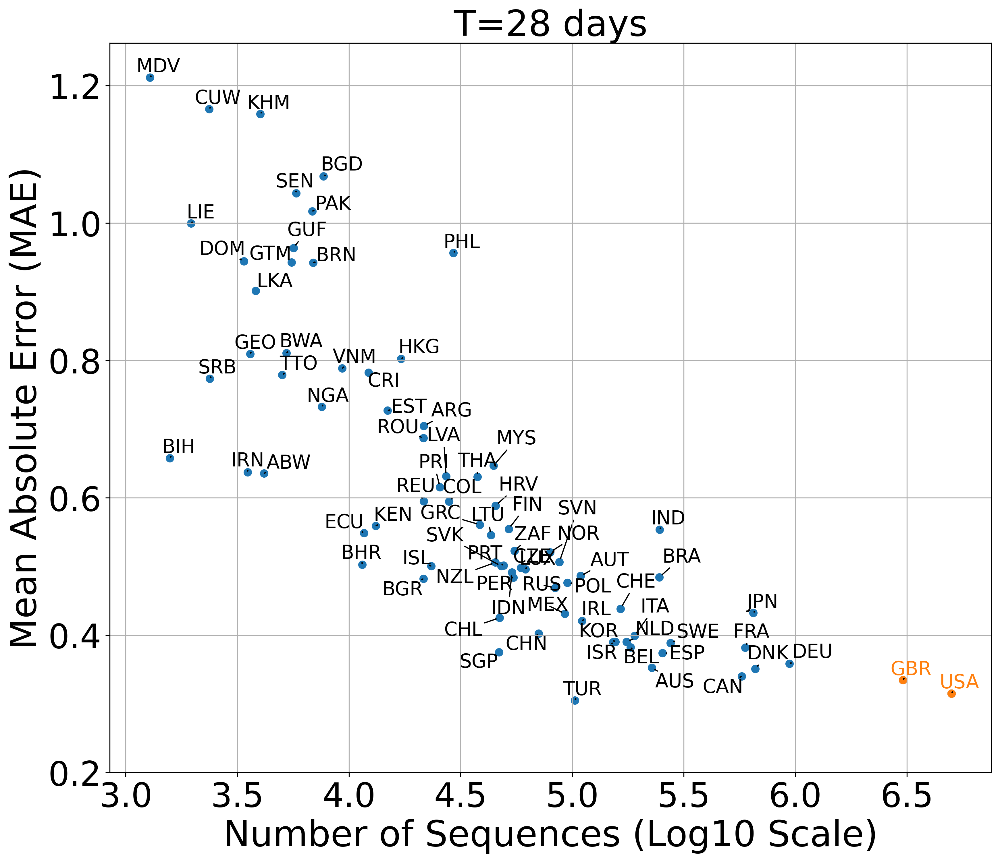

In [ ]:
plot_all_country_corr(country_info, pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, name_list, inputfreq_dict_list,
                     snr_dict_list, datapoint_dict_list, colors, norm=False, country_list=country_list, plot_list=[1,1,1,1],
                      valid_point=18, text_size=16, vline=70000, adjust_txt=True, split_date='2022-12-31', split_date_end='2024-02-28', c=1.2)

# Nextstrain

In [ ]:
import requests
import json
import copy
import numpy as np
import time
import pickle
from IPython.display import clear_output

## Function

In [ ]:
# @title import_cluster2
def import_cluster2():
  import importlib
  import clusters_dict_original_latest


  importlib.reload(clusters_dict_original_latest)
  from clusters_dict_original_latest import clusters

  return clusters

In [ ]:
# @title summary_lineage2
def summary_lineage2(true_dict_list, country, find=False):
    unique_keys = set()
    for d in true_dict_list:
        unique_keys.update(d.keys())
    unique_keys = [n for n in unique_keys if country in n]

    lineage_dict = {}
    lineage_name_dict = defaultdict(list)
    used_keys = ['pango_lineages', 'display_name', 'col']
    defined_keys = []

    c= import_cluster2()

    for k, v in c.items():
        if not set(used_keys).issubset(set(v.keys())):
            continue
        pango_lineages = v['pango_lineages']
        if not pango_lineages:
          continue
        col = v['col']
        display_name = v['display_name']
        lineage_dict[display_name] = [[], col]

        for l in pango_lineages:
            matching_keys = find_keys_with_special_prefix(unique_keys, country + '_' + l["name"])
            if not matching_keys:
                continue
            for m in matching_keys:
              lineage_name_dict[m].append([pango_lineages[0]["name"], display_name])
              defined_keys.append(m)

    for k, v in lineage_name_dict.items():
        display_name = max(v, key=lambda x: len(x[0]))
        lineage_dict[display_name[1]][0].append(k)

    item_counts = defaultdict(int)
    for values in lineage_dict.values():
        for l in values[0]:
            item_counts[l] += 1
    repeated_items = [item for item, count in item_counts.items() if count > 1]
    if repeated_items:
        print("Repeated items:", repeated_items)

    other_key = list(set(unique_keys) - set(defined_keys))
    new_color = ['#d0d5b9', '#b42c8e', '#09fdff', '#cf305f', '#b1d345', '#247c26', '#f60796', '#f0164d', '#c0ac37', '#2a1e77', '#e4590a', '#5f0cac', '#3ad03a']
    lineage_dict['other'] = [other_key, new_color[-1]]

    return lineage_dict

In [ ]:
# @title trans_dict2
def trans_dict2(original, lineage_dict, ground=True, log=True, resort=True, split_date = '2022-12-31'):
    transed = {}
    transed_x = {}

    other_list = []

    split = deal_str_date(split_date)

    for k, v in lineage_dict.items():

        y = []
        x = []

        for l in v[0]:
            if l in original.keys():
                data = original[l]
                if ground:
                    if log:
                        y.append(np.log10(data[:, -1]))
                    else:
                        y.append(data[:, -1])
                    x.append(data[:, 0])
                else:
                    y.append(data[1])
                    x.append(data[0])

            if k == 'other' and x and np.nanmax(x[-1])>split:
                if ground:
                  if log:
                    other_list.append([k,l,np.nanmax(np.log10(data[:, -1])),np.nanmax(x[-1])])
                  else:
                    other_list.append([k,l,np.nanmax(data[:, -1]),np.nanmax(x[-1])])
                else:
                  other_list.append([k,l,np.nanmax(data[1]),np.nanmax(x[-1])])

        if x and y:
            result_dict = {}
            for idx, vals in zip(x, y):
                for i, v in zip(idx, vals):
                    if i in result_dict:
                        result_dict[i] = np.log10(np.power(10, result_dict[i]) + np.power(10, v))
                    else:
                        result_dict[i] = v

            # Convert dictionary back to arrays if needed
            index_array = np.array(list(result_dict.keys()))
            value_array = np.array(list(result_dict.values()))

            if resort:
              sorted_indices = np.argsort(index_array)
              index_array = index_array[sorted_indices]
              value_array = value_array[sorted_indices]

            transed[k] = value_array
            transed_x[k] = index_array

    return transed, transed_x

In [ ]:
# @title cluster_clade
def cluster_clade(dict_list, norm, ground=False, log=False):
  all_dict_list = []
  for country in country_list:
    result_dict_list = []
    lineage_dict = summary_lineage2(dict_list, country)
    for i in range(len(dict_list)):
      transed, transed_x = trans_dict2(dict_list[i], lineage_dict, ground=ground, log=log)
      if norm:
        transed = process_dataset(transed, transed_x)

      result = {}
      for k in transed.keys():
        date = transed_x[k]
        data = transed[k] if not norm else np.log10(transed[k])

        result[country + '_' + k] = np.stack([date, data])

      result_dict_list.append(result)

    all_dict_list.append(result_dict_list)

  final = []
  for i in range(len(all_dict_list[0])):
    final_result = {}
    for j in range(len(all_dict_list)):
      final_result.update(all_dict_list[j][i])
    final.append(final_result)

  return final

In [ ]:
# @title bin_error2
def bin_error2(bin_centers, bin_edges, index, mae, num_samples=False):
    errors = []
    variances = []

    ns = []
    for i in range(len(bin_centers)):
        # print(type(index), index.shape)
        bin_mask = (index >= bin_edges[i]) & (index < bin_edges[i + 1])

        bin_errors = mae[bin_mask]
        bin_mean_error = np.nanmean(bin_errors) if bin_errors.size else np.nan
        bin_variance = np.nanvar(bin_errors) if bin_errors.size else np.nan
        errors.append(bin_mean_error)
        variances.append(bin_variance)

        ns.append(np.nansum(bin_mask))

    if num_samples:
        return np.array(errors), np.array(variances), np.array(ns)

    return np.array(errors), np.array(variances)


In [ ]:
# @title main_subplots2
def main_subplots2(ax1_1, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, index_list,
            pred_list, label_list, exp_date_list, exp_list, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, name, x_name, frontsize1, frontsize2, offset=False):

  ax1_2 = ax1_1.twinx()
  line1 = []

  base_offset = (bin_centers[1] - bin_centers[0])/offset if offset else 0
  capsize = 0

  for i in range(len(name_list)):
    k = i - len(name_list)/2 + 0.5
    line_name = name_list[i]
    line_color = colors[i]
    lf = line_format[i]
    future = future_list[i]

    index = index_list[i]
    date = date_list[i]
    pred = pred_list[i]
    true = label_list[i]
    strue = slabel_list[i]
    mae = np.abs(pred - true)
    noise = np.abs(strue - true)

    exp_date = exp_date_list[i]
    exp = exp_list[i]
    # exp_new = np.full(date.shape, np.nan)
    # indices = np.isin(date, exp_date)
    # exp_new[indices] = exp[np.searchsorted(exp_date, date[indices])]
    exp_mae = np.abs(exp - true)

    if split:
      time_mask = date >= split

      mae = mae[time_mask]
      exp_mae = exp_mae[time_mask]
      exp = exp[time_mask]
      index = index[time_mask]

    errors, variances =  bin_error2(bin_centers, bin_edges, index, mae)

    masks = np.isnan(errors)
    errors = errors[~masks]
    variances = variances[~masks]
    bin_centersm = bin_centers[~masks]

    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centersm + k*base_offset, errors, lf, label=line_name, color=line_color, ms=16, linewidth=3)
      ax1_1.errorbar(bin_centersm + k*base_offset, errors, yerr=variances, fmt='-',
                      color=line_color, alpha=0.7, ms=16, capsize=capsize, linewidth=3.5)
      line1 += l
    else:
      l = ax1_1.plot(bin_centersm[2:]+ k*base_offset, errors[2:], lf, label=line_name, color=line_color, ms=10)
      ax1_1.errorbar(bin_centersm+ k*base_offset, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.2, ms=10, capsize=capsize)
      line1 += l

      ax1_1.plot(bin_centersm[:2]+ k*base_offset, errors[:2], lf, color=line_color, alpha=0.2, ms=10)
      ax1_1.errorbar(bin_centersm+ k*base_offset, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.1, ms=10, capsize=capsize)


    if 'Prediction' not in name:
      errors, variances =  bin_error2(bin_centers, bin_edges, index, exp_mae)
    else:
      errors, variances =  bin_error2(bin_centers, bin_edges, exp, exp_mae)

    if np.isnan(errors).all() or np.isnan(variances).all():
      continue
    errors = errors[~masks]
    variances = variances[~masks]
    bin_centersm = bin_centers[~masks]

    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centersm + k*base_offset, errors, linestyle=(0, (5, 10)), marker='X', label=f'Nextstrain (T={future} days)', color=line_color, ms=16, linewidth=3)
      ax1_1.errorbar(bin_centersm + k*base_offset, errors, yerr=variances, linestyle=(0, (5, 10)),
                      color=line_color, alpha=0.7, ms=10, capsize=capsize, linewidth=3)
      line1 += l
    else:
      pass
      # l = ax1_1.plot(bin_centers[2:] + k*base_offset, errors[2:], '--o', label=f'Regression_{future}', color=line_color)
      # ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.2)
      # line1 += l

      # ax1_1.plot(bin_centers[:2] + k*base_offset, errors[:2], '--o', color=line_color, alpha=0.2)
      # ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.1)

  if 'SNR' not in name and '#Valid Data' not in name:
    # noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, noise_ind, noise_level, num_samples=True)
    date = date_list[0]
    index = index_list[0]
    true = label_list[0]
    strue = slabel_list[0]
    if split:
      time_mask = date >= split
      index = index[time_mask]
      true = true[time_mask]
      strue = strue[time_mask]
    noise = np.abs(strue - true)
    noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, index, noise, num_samples=True)

    l = ax1_1.plot(bin_centers, noise_level, linestyle='dashdot', label='Noise Level', color='k', ms=10, linewidth=3)
    line1 += l
    l = ax1_2.plot(bin_centers, num_samples, '-', label='Num of Samples', color='brown', linewidth=3)
    line1 += l


  # labels = [l.get_label() for l in line1]
  # zipped_lists = list(zip(line1, labels))
  # sorted_pairs = sorted(zipped_lists, key=lambda x: x[1])
  # if '#Valid Data' not in name:
  #     ind = len(sorted_pairs)//2 - 1
  #     sorted_pairs = sorted_pairs[2+ind:] + sorted_pairs[1:2] + sorted_pairs[2:2+ind] + sorted_pairs[0:1]
  # line1_sorted, labels_sorted = zip(*sorted_pairs)

  # ax1_1.legend(line1_sorted, labels_sorted, fontsize = 14, ncol=2)

  if x_labels:
    if 'Weeks' in name:
      ax1_1.set_xticks(bin_centers[::2])
      ax1_1.set_xticklabels(x_labels[::2])
    else:
      ax1_1.set_xticks(bin_centers)
      ax1_1.set_xticklabels(x_labels)
  ax1_1.tick_params(axis='y', labelsize=frontsize2)
  ax1_1.tick_params(axis='x', labelsize=frontsize2)
  # ax1_1.set_title(name[:-4], fontsize = frontsize1)
  ax1_1.set_ylabel('MAE', fontsize = frontsize1)

  formatter = ticker.ScalarFormatter(useMathText=True)
  formatter.set_scientific(True)
  formatter.set_powerlimits((-1,1))
  ax1_2.yaxis.set_major_formatter(formatter)
  ax1_2.yaxis.offsetText.set_fontsize(frontsize2)
  ax1_2.tick_params(axis='y', labelsize=frontsize2)
  ax1_2.set_ylabel('Num of Samples', fontsize = frontsize1)
  ax1_2.yaxis.label.set_color('brown')
  ax1_2.tick_params(colors='brown', which='both')

  ax1_1.set_xlabel(x_name, fontsize = frontsize1)

  labels = [l.get_label() for l in line1]
  return line1, labels

In [ ]:
# @title plot_main_result2
def plot_main_result2(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, original, smoothed, name_list,
            noise_level, noise_ind, noise_ind2, future_list, colors, line_format, country='', norm=False, split_date='2022-12-31', offset=False):
    key_list_all = set()
    for d in true_dict_list:
        key_list_all.update(d.keys())
    key_list_all = list(key_list_all)
    key_list = [item for item in key_list_all if country in item]

    lineage_dict={}
    for k in key_list:
      lineage_dict[k] = [[k],'']

    if norm:
      pred_dict_list, exp_dict_list = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)

    date_list, pred_list, label_list, slabel_list, exp_date_list, exp_list = [], [], [], [], [], []
    aligned_date_list = []
    mask_list = []
    model_error_list, model_name_list = [], []
    for i, n in enumerate(name_list):
      date, pred, label, slabel, exp_date, exp = [], [], [], [], [], []
      aligned_date = []

      for k in pred_dict_list[i].keys():
        date.append(pred_dict_list[i][k][0])
        aligned_date.append(np.arange(pred_dict_list[i][k][0].shape[0]))
        pred.append(pred_dict_list[i][k][1])
        label.append(true_dict_list[i][k][1])
        slabel.append(true_smooth_dict_list[i][k][1])

        exp_date.append(exp_dict_list[i][k][0])
        exp.append(exp_dict_list[i][k][1])

      date_list.append(np.concatenate(date))
      aligned_date_list.append(np.concatenate(aligned_date))
      exp_date_list.append(np.concatenate(exp_date))

      exp = np.concatenate(exp)
      exp = np.clip(exp, -4, 0)
      mask = np.isnan(exp)
      exp_list.append(exp)

      pred = np.concatenate(pred)
      pred[mask] = np.nan
      pred_list.append(pred)


      label = np.concatenate(label)
      label[mask] = np.nan
      label_list.append(label)

      slabel = np.concatenate(slabel)
      slabel[mask] = np.nan
      slabel_list.append(slabel)

      # model_error_list.append(np.abs(pred-label))
      model_error_list.append(pred-label)
      model_name_list.append(n)
      # model_error_list.append(np.abs(exp-label))
      model_error_list.append(exp-label)
      model_name_list.append(f'Nextstrain (T={future_list[i]} days)')

    smooth_date, smooth = [], []
    raw_date, raw = [], []
    for k in key_list:
      smooth_date.append(smoothed[k][:, 0])
      smooth.append(smoothed[k][:, 1])
      raw_date.append(original[k][:, 0])
      raw.append(original[k][:, 1])
    smooth_date = np.concatenate(smooth_date)
    smooth = np.concatenate(smooth)
    raw_date = np.concatenate(raw_date)
    raw = np.concatenate(raw)

    if split_date:
      split = deal_str_date(split_date)
    else:
      split = None

    height = 22
    weight = height*1.715
    fig = plt.figure(figsize=(weight, height), dpi=300)

    gs = GridSpec(2, 6, figure=fig)
    axA = fig.add_subplot(gs[0, :3])
    axB = fig.add_subplot(gs[0, 3:])
    axC = fig.add_subplot(gs[1:, :3])
    axLegend = fig.add_subplot(gs[1, 3:])

    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 40

    print(np.max(aligned_date_list[0]), np.min(aligned_date_list[0]))
    print(aligned_date_list[0][0])
    print(pred_list[0][0])
    print(exp_list[0][0])

    bin_edges = np.arange(0, 147, 7)
    bin_centers = bin_edges[:-1] + 7 / 2
    x_labels = [int(d//7+1) for d in bin_centers]

    bin_edges = np.concatenate([bin_edges, np.array([238])])
    bin_centers = bin_edges[:-1] + 7 / 2
    x_labels += ['20+']
    offset_value = 10 if offset else False
    handles1, labels1 = main_subplots2(axC, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, aligned_date_list,
            pred_list, label_list, exp_date_list, exp_list, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, f'Weeks vs. MAE.png', 'Weeks', frontsize1, frontsize2, offset=offset_value)

    ## Pred
    bin_edges = np.arange(-4.75, 0.25, 0.5)
    bin_centers = bin_edges[:-1] + 0.5 / 2
    x_labels = ["{:.1f}".format(d) for d in bin_centers]  # ["{:.2f}".format(np.power(10,d)) for d in bin_centers]
    offset_value = 20 if offset else False
    handles2, labels2 = main_subplots2(axB,bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, pred_list,
            pred_list, label_list, exp_date_list, exp_list, smooth, raw, slabel_list,
            noise_ind2, noise_level, x_labels, split, f'Prediction Freq. vs. MAE.png', 'Prediction Freq.(log10 scale)', frontsize1, frontsize2, offset=offset_value)

    ## Barplot
    mean_error_list, mean_name_list, color_list, fill_list, style_list = [], [], [], [], []
    for i, n in enumerate(model_name_list):
      if 'Nextstrain' not in model_name_list[i]:
        mean_error_list.append(np.nanmean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i//2])
        fill_list.append(colors[i//2])
        style_list.append(None)
    for i, n in enumerate(model_name_list):
      if 'Nextstrain' in model_name_list[i]:
        mean_error_list.append(np.nanmean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i//2])
        fill_list.append('none')
        style_list.append('\\')

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    true = label_list[0]
    strue = slabel_list[0]
    mean_noise = np.nanmean(np.abs(strue - true))

    bars = axA.bar(x, mean_error_list, edgecolor=color_list)
    for i, bar in enumerate(bars):
      bar.set_facecolor(fill_list[i])
      bar.set_hatch(style_list[i])

    axA.set_xticks(np.arange(len(mean_name_list)))
    ll = axA.set_xticklabels(mean_name_list, fontsize = frontsize2, rotation=-20, ha='left')
    trans = mtransforms.ScaledTranslation(-25/72., 0, fig.dpi_scale_trans) # 5 points to the left
    # Apply the transformation to each label
    for label in ll:
        label.set_transform(label.get_transform() + trans)

    axA.tick_params(axis='y', labelsize=frontsize2)

    axA.hlines(mean_noise, -1, len(mean_name_list), colors='k', linestyles='dashdot', label='Noise Level', linewidth=3)
    print(f'Mean Noise: {mean_noise}')

    # axA.set_title('Model Errors', fontsize = frontsize1)
    axA.set_ylabel('MAE', fontsize = frontsize1)
    # axA.set_xlabel('Model Names', fontsize = frontsize1)
    axA.set_xlim(-0.5, len(mean_name_list)-0.5)
    axA.legend(fontsize = frontsize1)


    h, w = -0.05, 1.1
    axA.text(h, w, 'a', transform=axA.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    axB.text(h, w, 'b', transform=axB.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    axC.text(h, w, 'c', transform=axC.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')

    # handles1, labels1 = axB.get_legend_handles_labels()
    # handles2, labels2 = axC.get_legend_handles_labels()
    all_handles = handles1 # + handles2
    all_labels = labels1 # + labels2

    unique = list({(label, handle) for handle, label in zip(all_handles, all_labels)})
    unique = sorted(unique, key=lambda x: x[0])
    ind = len(unique)//2 - 1
    unique = unique[ind+2:] + unique[ind+1:ind+2]  + unique[:ind] + unique[ind:ind+1]
    unique_labels, unique_handles = zip(*unique)

    axLegend.axis('off')
    axLegend.legend(unique_handles, unique_labels, loc='center', fontsize = frontsize1, ncol=2, labelspacing=0.9, frameon=False)

    # plt.tight_layout(pad=0.01)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.4, hspace=0.4)


    fig.savefig('main_results.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [ ]:
# @title plot_main_result2_2
def plot_main_result2_2(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, original, smoothed, name_list,
            noise_level, noise_ind, noise_ind2, future_list, colors, line_format, country='', norm=False, split_date='2022-12-31', offset=False):
    key_list_all = set()
    for d in true_dict_list:
        key_list_all.update(d.keys())
    key_list_all = list(key_list_all)
    key_list = [item for item in key_list_all if country in item]

    lineage_dict={}
    for k in key_list:
      lineage_dict[k] = [[k],'']

    if norm:
      pred_dict_list, exp_dict_list = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)

    date_list, pred_list, label_list, slabel_list, exp_date_list, exp_list = [], [], [], [], [], []
    aligned_date_list = []
    mask_list = []
    model_error_list, model_name_list = [], []
    for i, n in enumerate(name_list):
      date, pred, label, slabel, exp_date, exp = [], [], [], [], [], []
      aligned_date = []

      for k in pred_dict_list[i].keys():
        if k not in exp_dict_list[i]:
          continue
        date.append(pred_dict_list[i][k][0])
        aligned_date.append(np.arange(pred_dict_list[i][k][0].shape[0]))
        pred.append(pred_dict_list[i][k][1])
        label.append(true_dict_list[i][k][1])
        slabel.append(true_smooth_dict_list[i][k][1])

        exp_date.append(exp_dict_list[i][k][0])
        exp.append(exp_dict_list[i][k][1])

      date_list.append(np.concatenate(date))
      aligned_date_list.append(np.concatenate(aligned_date))
      exp_date_list.append(np.concatenate(exp_date))

      exp = np.concatenate(exp)
      exp = np.clip(exp, -4, 0)
      mask = np.isnan(exp)
      exp_list.append(exp)

      pred = np.concatenate(pred)
      pred[mask] = np.nan
      pred_list.append(pred)


      label = np.concatenate(label)
      label[mask] = np.nan
      label_list.append(label)

      slabel = np.concatenate(slabel)
      slabel[mask] = np.nan
      slabel_list.append(slabel)

      # model_error_list.append(np.abs(pred-label))
      model_error_list.append(pred-label)
      model_name_list.append(n)
      # model_error_list.append(np.abs(exp-label))
      model_error_list.append(exp-label)
      model_name_list.append(f'Nextstrain (T={future_list[i]} days)')

    smooth_date, smooth = [], []
    raw_date, raw = [], []
    for k in key_list:
      smooth_date.append(smoothed[k][:, 0])
      smooth.append(smoothed[k][:, 1])
      raw_date.append(original[k][:, 0])
      raw.append(original[k][:, 1])
    smooth_date = np.concatenate(smooth_date)
    smooth = np.concatenate(smooth)
    raw_date = np.concatenate(raw_date)
    raw = np.concatenate(raw)

    if split_date:
      split = deal_str_date(split_date)
    else:
      split = None

    height = 11
    weight = 22*1.715
    fig = plt.figure(figsize=(weight, height), dpi=300)

    gs = GridSpec(1, 6, figure=fig)
    axA = fig.add_subplot(gs[0, :3])
    axB = fig.add_subplot(gs[0, 3:])
    # axC = fig.add_subplot(gs[1:, :3])
    # axLegend = fig.add_subplot(gs[1, 3:])

    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 40

    print(np.max(aligned_date_list[0]), np.min(aligned_date_list[0]))
    print(aligned_date_list[0][0])
    print(pred_list[0][0])
    print(exp_list[0][0])

    # bin_edges = np.arange(0, 147, 7)
    # bin_centers = bin_edges[:-1] + 7 / 2
    # x_labels = [int(d//7+1) for d in bin_centers]

    # bin_edges = np.concatenate([bin_edges, np.array([238])])
    # bin_centers = bin_edges[:-1] + 7 / 2
    # x_labels += ['20+']
    # offset_value = 10 if offset else False
    # handles1, labels1 = main_subplots2(axC, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, aligned_date_list,
    #         pred_list, label_list, exp_date_list, exp_list, smooth, raw, slabel_list,
    #         noise_ind, noise_level, x_labels, split, f'Weeks vs. MAE.png', 'Weeks', frontsize1, frontsize2, offset=offset_value)

    ## Pred
    bin_edges = np.arange(-4.75, 0.25, 0.5)
    bin_centers = bin_edges[:-1] + 0.5 / 2
    x_labels = ["{:.1f}".format(d) for d in bin_centers]  # ["{:.2f}".format(np.power(10,d)) for d in bin_centers]
    offset_value = 20 if offset else False
    handles2, labels2 = main_subplots2(axB,bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, pred_list,
            pred_list, label_list, exp_date_list, exp_list, smooth, raw, slabel_list,
            noise_ind2, noise_level, x_labels, split, f'Prediction Freq. vs. MAE.png', 'Prediction Freq.(log10 scale)', frontsize1, frontsize2, offset=offset_value)

    ## Barplot
    mean_error_list, mean_name_list, color_list, fill_list, style_list = [], [], [], [], []
    for i, n in enumerate(model_name_list):
      if 'Nextstrain' not in model_name_list[i]:
        mean_error_list.append(np.nanmean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i//2])
        fill_list.append(colors[i//2])
        style_list.append(None)
    for i, n in enumerate(model_name_list):
      if 'Nextstrain' in model_name_list[i]:
        mean_error_list.append(np.nanmean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i//2])
        fill_list.append('none')
        style_list.append('\\')

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    true = label_list[0]
    strue = slabel_list[0]
    mean_noise = np.nanmean(np.abs(strue - true))

    bars = axA.bar(x, mean_error_list, edgecolor=color_list)
    for i, bar in enumerate(bars):
      bar.set_facecolor(fill_list[i])
      bar.set_hatch(style_list[i])

    axA.set_xticks(np.arange(len(mean_name_list)))
    ll = axA.set_xticklabels(mean_name_list, fontsize = frontsize2, rotation=-20, ha='left')
    trans = mtransforms.ScaledTranslation(-25/72., 0, fig.dpi_scale_trans) # 5 points to the left
    # Apply the transformation to each label
    for label in ll:
        label.set_transform(label.get_transform() + trans)

    axA.tick_params(axis='y', labelsize=frontsize2)

    axA.hlines(mean_noise, -1, len(mean_name_list), colors='k', linestyles='dashdot', label='Noise Level', linewidth=3)
    print(f'Mean Noise: {mean_noise}')

    # axA.set_title('Model Errors', fontsize = frontsize1)
    axA.set_ylabel('MAE', fontsize = frontsize1)
    # axA.set_xlabel('Model Names', fontsize = frontsize1)
    axA.set_xlim(-0.5, len(mean_name_list)-0.5)
    axA.legend(fontsize = frontsize1)


    h, w = -0.05, 1.1
    axA.text(h, w, 'a', transform=axA.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    axB.text(h, w, 'b', transform=axB.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    # axC.text(h, w, 'c', transform=axC.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')

    # handles1, labels1 = axB.get_legend_handles_labels()
    # handles2, labels2 = axC.get_legend_handles_labels()
    all_handles = handles2 # + handles2
    all_labels = labels2 # + labels2

    unique = list({(label, handle) for handle, label in zip(all_handles, all_labels)})
    unique = sorted(unique, key=lambda x: x[0])
    ind = len(unique)//2 - 1
    unique = unique[ind+2:] + unique[:ind] + unique[ind+1:ind+2] + unique[ind:ind+1]
    unique_labels, unique_handles = zip(*unique)

    # axLegend.axis('off')
    axB.legend(unique_handles, unique_labels, fontsize = frontsize1, ncol=1, labelspacing=0.6, frameon=True, loc='upper left')

    # plt.tight_layout(pad=0.01)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.4, hspace=0.4)


    suff = '_normed' if norm else ''
    fig.savefig(f'NextStrain{suff}_new.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [ ]:
# @title plot_main_result3
def process_and_append_data(date, aligned_date, pred, label, slabel, exp_date, exp, date_list, aligned_date_list,
              pred_list, label_list, slabel_list, exp_date_list, exp_list, model_error_list, model_name_list, model_name, future):
    # Common processing and appending logic
    date_list.append(np.concatenate(date))
    aligned_date_list.append(np.concatenate(aligned_date))
    exp_date_list.append(np.concatenate(exp_date))

    exp = np.concatenate(exp)
    exp = np.clip(exp, -4, 0)
    mask = np.isnan(exp)
    exp_list.append(exp)

    pred = np.concatenate(pred)
    pred[mask] = np.nan
    pred_list.append(pred)

    label = np.concatenate(label)
    label[mask] = np.nan
    label_list.append(label)

    slabel = np.concatenate(slabel)
    slabel[mask] = np.nan
    slabel_list.append(slabel)

    model_error_list.append(pred - label)
    model_name_list.append(model_name)
    model_error_list.append(exp - label)
    model_name_list.append(f'Nextstrain (T={future} days)')

def create_bar_plot(model_error_list, model_name_list, colors, frontsize2, frontsize1, frontsize3, axA):
    mean_error_list, mean_name_list, color_list, fill_list, style_list = [], [], [], [], []
    for i, n in enumerate(model_name_list):
        if 'Nextstrain' not in n:
            mean_error_list.append(np.nanmean(np.abs(model_error_list[i])))
            mean_name_list.append(n)
            color_list.append(colors[i//2])
            fill_list.append(colors[i//2])
            style_list.append(None)
    for i, n in enumerate(model_name_list):
        if 'Nextstrain' in n:
            mean_error_list.append(np.nanmean(np.abs(model_error_list[i])))
            mean_name_list.append(n)
            color_list.append(colors[i//2])
            fill_list.append('none')
            style_list.append('\\')

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    bars = axA.bar(x, mean_error_list, edgecolor=color_list)
    for i, bar in enumerate(bars):
        bar.set_facecolor(fill_list[i])
        bar.set_hatch(style_list[i])

    axA.set_xticks(np.arange(len(mean_name_list)))
    ll = axA.set_xticklabels(mean_name_list, fontsize=frontsize2, rotation=-20, ha='left')
    trans = mtransforms.ScaledTranslation(-25/72., 0, plt.gcf().dpi_scale_trans) # 5 points to the left
    for label in ll:
        label.set_transform(label.get_transform() + trans)

    axA.tick_params(axis='y', labelsize=frontsize2)
    axA.set_ylabel('MAE', fontsize=frontsize1)
    axA.set_xlim(-0.5, len(mean_name_list)-0.5)
    axA.text(-0.05, 1.1, 'a', transform=axA.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')

    return axA

def plot_main_result3(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, original, smoothed, name_list,
            noise_level, noise_ind, noise_ind2, future_list, colors, line_format, country='', norm=False, split_date='2022-12-31', offset=False):
    key_list_all = set()
    for d in true_dict_list:
        key_list_all.update(d.keys())
    key_list_all = list(key_list_all)
    key_list = [item for item in key_list_all if country in item]

    lineage_dict={}
    for k in key_list:
      lineage_dict[k] = [[k],'']

    if norm:
      pred_dict_list, exp_dict_list = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)

    # Lists for category 1
    date_list_cat1, pred_list_cat1, label_list_cat1, slabel_list_cat1, exp_date_list_cat1, exp_list_cat1 = [], [], [], [], [], []
    aligned_date_list_cat1 = []
    model_error_list_cat1, model_name_list_cat1 = [], []

    # Lists for category 2
    date_list_cat2, pred_list_cat2, label_list_cat2, slabel_list_cat2, exp_date_list_cat2, exp_list_cat2 = [], [], [], [], [], []
    aligned_date_list_cat2 = []
    model_error_list_cat2, model_name_list_cat2 = [], []
    for i, n in enumerate(name_list):
      date_cat1, pred_cat1, label_cat1, slabel_cat1, exp_date_cat1, exp_cat1 = [], [], [], [], [], []
      aligned_date_cat1 = []
      date_cat2, pred_cat2, label_cat2, slabel_cat2, exp_date_cat2, exp_cat2 = [], [], [], [], [], []
      aligned_date_cat2 = []

      for k in pred_dict_list[i].keys():
        if k in ['GBR_22F (Omicron)', 'GBR_23B (Omicron)', 'USA_22F (Omicron)', 'USA_23B (Omicron)']:
          # Append data to category 1 lists
          date_cat1.append(pred_dict_list[i][k][0])
          aligned_date_cat1.append(np.arange(pred_dict_list[i][k][0].shape[0]))
          pred_cat1.append(pred_dict_list[i][k][1])
          label_cat1.append(true_dict_list[i][k][1])
          slabel_cat1.append(true_smooth_dict_list[i][k][1])
          exp_date_cat1.append(exp_dict_list[i][k][0])
          exp_cat1.append(exp_dict_list[i][k][1])
        else: # GBR_23A (Omicron), USA_23A (Omicron), USA_22E (Omicron)
          # Append data to category 2 lists
          date_cat2.append(pred_dict_list[i][k][0])
          aligned_date_cat2.append(np.arange(pred_dict_list[i][k][0].shape[0]))
          pred_cat2.append(pred_dict_list[i][k][1])
          label_cat2.append(true_dict_list[i][k][1])
          slabel_cat2.append(true_smooth_dict_list[i][k][1])
          exp_date_cat2.append(exp_dict_list[i][k][0])
          exp_cat2.append(exp_dict_list[i][k][1])


      process_and_append_data(date_cat1, aligned_date_cat1, pred_cat1, label_cat1, slabel_cat1, exp_date_cat1, exp_cat1, date_list_cat1, aligned_date_list_cat1,
                              pred_list_cat1, label_list_cat1, slabel_list_cat1, exp_date_list_cat1, exp_list_cat1, model_error_list_cat1, model_name_list_cat1, n, future_list[i])
      process_and_append_data(date_cat2, aligned_date_cat2, pred_cat2, label_cat2, slabel_cat2, exp_date_cat2, exp_cat2, date_list_cat2, aligned_date_list_cat2,
                              pred_list_cat2, label_list_cat2, slabel_list_cat2, exp_date_list_cat2, exp_list_cat2, model_error_list_cat2, model_name_list_cat2, n, future_list[i])

    smooth_date, smooth = [], []
    raw_date, raw = [], []
    for k in key_list:
      smooth_date.append(smoothed[k][:, 0])
      smooth.append(smoothed[k][:, 1])
      raw_date.append(original[k][:, 0])
      raw.append(original[k][:, 1])
    smooth_date = np.concatenate(smooth_date)
    smooth = np.concatenate(smooth)
    raw_date = np.concatenate(raw_date)
    raw = np.concatenate(raw)

    if split_date:
      split = deal_str_date(split_date)
    else:
      split = None

    height = 22
    weight = height*1.715 / 2
    fig = plt.figure(figsize=(weight, height), dpi=300)

    gs = GridSpec(2, 3, figure=fig)
    axA = fig.add_subplot(gs[0, :3])
    axB = fig.add_subplot(gs[1, :3])

    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 40
    ## Barplot
    create_bar_plot(model_error_list_cat1, model_name_list_cat1, colors, frontsize2, frontsize1, frontsize3, axA)
    create_bar_plot(model_error_list_cat2, model_name_list_cat2, colors, frontsize2, frontsize1, frontsize3, axB)

    axA.set_title('Rising', fontsize=frontsize1)
    axB.set_title('Falling', fontsize=frontsize1)

    combined_y_min = min(axA.get_ylim()[0], axB.get_ylim()[0])
    combined_y_max = max(axA.get_ylim()[1], axB.get_ylim()[1])
    axA.set_ylim(combined_y_min, combined_y_max)
    axB.set_ylim(combined_y_min, combined_y_max)

    # plt.tight_layout(pad=0.01)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.4, hspace=0.4)


    fig.savefig('main_results.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [ ]:
# @title plot_all_country2
def plot_all_country2(country_info, pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, name_list, colors, norm=False, country_list=None, sorted_indices=None, plot_list=[1,1,1,1]):
    if country_list is None:
        country_list = ['GBR', 'USA']
    result_dict = {}
    num_lineage = {}
    for country in country_list:
      num_lineage[country] = 0

    for country in country_list:
        key_list_all = set()
        key_list_all.update(true_dict_list.keys())
        key_list_all = list(key_list_all)
        key_list = [item for item in key_list_all if country in item]


        lineage_dict = {}
        for k in key_list:
            lineage_dict[k] = [[k], '']

        if norm:
            pred_dict_list_normed, exp_dict_list_normed = norm_the_result([pred_dict_list], [exp_dict_list], lineage_dict)
            pred_dict_list_normed = pred_dict_list_normed[0]
            exp_dict_list_normed = exp_dict_list_normed[0]
        else:
            pred_dict_list_normed = pred_dict_list
            exp_dict_list_normed = exp_dict_list

        date_list, input_freq_list, pred_list, label_list, slabel_list, exp_date_list, exp_list, snr_list, num_data_list = [], [], [], [], [], [], [], [], []
        aligned_date_list = []
        mask_list = []
        model_error_list, model_name_list = [], []
        date, input_freq, pred, label, slabel, exp_date, exp, snr, num_data = [], [], [], [], [], [], [], [], []
        aligned_date = []

        for k in pred_dict_list_normed.keys():
            if country not in k:
                continue
            num_lineage[country] += 1

            date.append(pred_dict_list_normed[k][0])
            aligned_date.append(np.arange(pred_dict_list_normed[k][0].shape[0]))
            pred.append(pred_dict_list_normed[k][1])
            label.append(true_dict_list[k][1])
            slabel.append(true_smooth_dict_list[k][1])

            exp_date.append(exp_dict_list_normed[k][0])
            exp.append(exp_dict_list_normed[k][1])

        date_list = np.concatenate(date)
        aligned_date_list = np.concatenate(aligned_date)
        pred_list = np.concatenate(pred)
        label_list = np.concatenate(label)
        slabel_list = np.concatenate(slabel)
        exp_date_list = np.concatenate(exp_date)
        exp_list = np.concatenate(exp)


        model_error_list = pred_list - label_list
        model_name_list = name_list

        split = deal_str_date('2022-12-31') if country in ['GBR', 'USA'] else deal_str_date('2020-12-31')

        time_mask = date_list >= split
        model_error_list = model_error_list[time_mask]

        mask = np.isnan(model_error_list)
        model_error_list = model_error_list[~mask]

        color = "#0c84c6" if country not in ['GBR', 'USA'] else "#ffa510"
        result_dict[country] = [model_error_list, color, color, None]

    mean_error_list, mean_name_list, color_list, fill_list, style_list, num_list = [], [], [], [], [], []
    error_list, lineage_list = [], []
    for k, v in result_dict.items():
        if np.isnan(v[0]).all() or not v[0].shape[0]:
          continue
        mean_error_list.append(np.nanmean(np.abs(v[0])))
        color_list.append(v[1])
        fill_list.append(v[2])
        style_list.append(v[3])
        num_list.append(country_info[k])
        lineage_list.append(num_lineage[k])
        mean_name_list.append(k)
        error_list.append(v[0])

    def sorting_key(index):
      # Priority to 'GBR' and 'USA'
        if mean_name_list[index] in ['GBR', 'USA']:
            return (0, 0)  # 0 for highest priority, 0 for error to make it first
        else:
            return (1, mean_error_list[index])  # 1 for lower priority, sort by error

    # Sort indices based on custom key
    if not sorted_indices:
        sorted_indices = sorted(range(len(mean_name_list)), key=sorting_key)

    # Reorder all lists based on sorted indices
    mean_error_list = [mean_error_list[i] for i in sorted_indices]
    mean_name_list = [mean_name_list[i] for i in sorted_indices]
    color_list = [color_list[i] for i in sorted_indices]
    fill_list = [fill_list[i] for i in sorted_indices]
    style_list = [style_list[i] for i in sorted_indices]
    num_list = [num_list[i] for i in sorted_indices]
    lineage_list = [lineage_list[i] for i in sorted_indices]
    country_list = [country_list[i] for i in sorted_indices]
    error_list = [error_list[i] for i in sorted_indices]

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    ###### Barplot
    height = 22
    weight = height * 2
    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 40
    if norm:
      name_list += '_normed'

    if plot_list[0]:
      fig = plt.figure(figsize=(weight, height), dpi=300)

      gs = GridSpec(1, 3, figure=fig)
      axA = fig.add_subplot(gs[0, :])
      bars = axA.bar(x, mean_error_list, edgecolor=color_list)
      for i, bar in enumerate(bars):
        bar.set_facecolor(fill_list[i])
        bar.set_hatch(style_list[i])

      axA.set_xticks(np.arange(len(mean_name_list)))
      vertical_labels = ['\n'.join(label) for label in mean_name_list]
      ll = axA.set_xticklabels(vertical_labels, fontsize=frontsize2) # , ha='left'
      # trans = mtransforms.ScaledTranslation(-25 / 72., 0, fig.dpi_scale_trans)  # 5 points to the left
      # # Apply the transformation to each label
      # for label in ll:
      #     label.set_transform(label.get_transform() + trans)
      axA.tick_params(axis='y', labelsize=frontsize2)
      # axA.set_title('Model Errors', fontsize = frontsize1)
      axA.set_ylabel('MAE', fontsize=frontsize1)
      # axA.set_xlabel('Model Names', fontsize = frontsize1)
      axA.set_xlim(-0.5, len(mean_name_list) - 0.5)
      axA.set_ylim(0, np.max([1, np.nanmax(mean_error_list)]))

      axB = axA.twinx()
      axB.plot(x, np.array(num_list), color='k', linestyle='dashdot', label='Total Seqs', linewidth=3)
      formatter = ticker.ScalarFormatter(useMathText=True)
      formatter.set_scientific(True)
      formatter.set_powerlimits((-1, 1))
      axB.yaxis.set_major_formatter(formatter)
      axB.yaxis.offsetText.set_fontsize(frontsize2)
      axB.tick_params(axis='y', labelsize=frontsize2)
      axB.set_ylabel('Total Seqs', fontsize=frontsize1)
      axB.legend(fontsize=frontsize1)

      # plt.tight_layout(pad=0.01)
      plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.4, hspace=0.4)
      fig.savefig(f'all_country_{name_list}.png', bbox_inches='tight', pad_inches=0)
      plt.show()
      plt.close()

    ###### Boxplot
    if plot_list[1]:
      fig2 = plt.figure(figsize=(weight, height), dpi=300)
      gs = GridSpec(1, 3, figure=fig2)
      axC = fig2.add_subplot(gs[0, :])

      print(len(mean_name_list))

      axC.boxplot(error_list)

      axC.set_xticks(np.arange(len(mean_name_list))+1)
      vertical_labels = ['\n'.join(label) for label in mean_name_list]
      ll = axC.set_xticklabels(vertical_labels, fontsize=frontsize2) # , ha='left'
      axC.tick_params(axis='y', labelsize=frontsize2)
      axC.set_ylabel('Error', fontsize=frontsize1)
      axC.set_xlim(0.5, len(mean_name_list) + 0.5)

      axD = axC.twinx()
      axD.plot(x+1, np.array(num_list), color='k', linestyle='dashdot', label='Total Seqs', linewidth=3)
      formatter = ticker.ScalarFormatter(useMathText=True)
      formatter.set_scientific(True)
      formatter.set_powerlimits((-1, 1))
      axD.yaxis.set_major_formatter(formatter)
      axD.yaxis.offsetText.set_fontsize(frontsize2)
      axD.tick_params(axis='y', labelsize=frontsize2)
      axD.set_ylabel('Total Seqs', fontsize=frontsize1)
      axD.legend(fontsize=frontsize1)

      # plt.tight_layout(pad=0.01)
      plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.4, hspace=0.4)

      fig2.savefig(f'all_country_box_{name_list}.png', bbox_inches='tight', pad_inches=0)
      plt.show()
      plt.close()

    ###### Correlation Plot
    if plot_list[2]:
      plot_correlation(np.array(num_list), mean_error_list, mean_name_list, name_list+'_num_seqs')
    if plot_list[3]:
      plot_correlation(np.array(lineage_list), mean_error_list, mean_name_list, name_list+'_num_lineages')

    print(mean_name_list)

    return sorted_indices

In [ ]:
h = np.array([np.nan,np.nan,np.nan])
m = np.isnan(h)
h = h[~m]
print(h.shape)
if h.shape[0]:
  print(1111)

(0,)


## Plot

In [ ]:
filename = 'drive/MyDrive/Covid_UK/time_data/plot_result/all_results_best_14_21_28_35_42_60_latest2_noise.pkl.gz' #all_results_best_14_21_28_35_42_60_all_country
result = load_all(filename)

for k, v in result.items():
    globals()[k] = v

colors = ["#ffa510","#ffbd66", "#41b7ac", "#0c84c6", "#2455a4", "#002c53"]

In [ ]:
date_max = 0
date_min = np.inf
for d in true_dict_list:
    for key in d:
        date = np.nanmax(d[key][0, :])
        date_max = max(date, date_max)

        date = np.nanmin(d[key][0, :])
        date_min = min(date, date_min)
print(date_max)
print(date_min)

1511.0
380.0


In [ ]:
file_path = 'drive/MyDrive/Covid_UK/time_data/collect_date_v4/Number_totalSeqs.csv'
df = pd.read_csv(file_path)
country_list = df['Country'].tolist()
totalseq_list = df['totalSeqs'].tolist()
country_info = {}
for c, t in zip(country_list, totalseq_list):
  country_info[c] = t

In [ ]:
norm = True
pred = cluster_clade(pred_dict_list, norm=norm)
del pred_dict_list, snr_dict_list, datapoint_dict_list, inputfreq_dict_list, error_dict_list
true =  cluster_clade(true_dict_list, norm=False)
del true_dict_list
true_smooth = cluster_clade(true_smooth_dict_list, norm=False)
del true_smooth_dict_list
raw_clade =  cluster_clade([raw], norm=False)[0]
del raw
smoothed_clade =  cluster_clade([smoothed], norm=False)[0]
del smoothed

<ipython-input-93-c4a0ef8a82f1>:42: RuntimeWarning: overflow encountered in power
  result_dict[i] = np.log10(np.power(10, result_dict[i]) + np.power(10, v))
<ipython-input-93-c4a0ef8a82f1>:42: RuntimeWarning: overflow encountered in scalar add
  result_dict[i] = np.log10(np.power(10, result_dict[i]) + np.power(10, v))


In [ ]:
file_path = 'drive/MyDrive/Covid_UK/time_data/plot_result/mlr_all_country_latest_noise.pkl'
with open(file_path, 'rb') as file:
    mlr = pickle.load(file)

# file_path = 'mlr.pkl'
# with open(file_path, 'rb') as file:
#     mlr_old = pickle.load(file)

In [ ]:
for d in mlr:
    for key in d:
      if 'other' in key:
        d[key][1, :] = np.nan

In [ ]:
name_list = ['Transformer (T=14 days)',
 'Transformer (T=21 days)',
 'Transformer (T=28 days)',
 'Transformer (T=35 days)',
 'Transformer (T=42 days)',
 'Transformer (T=60 days)']

1010 0
0
nan
nan
Mean Noise: 0.19089336958332598


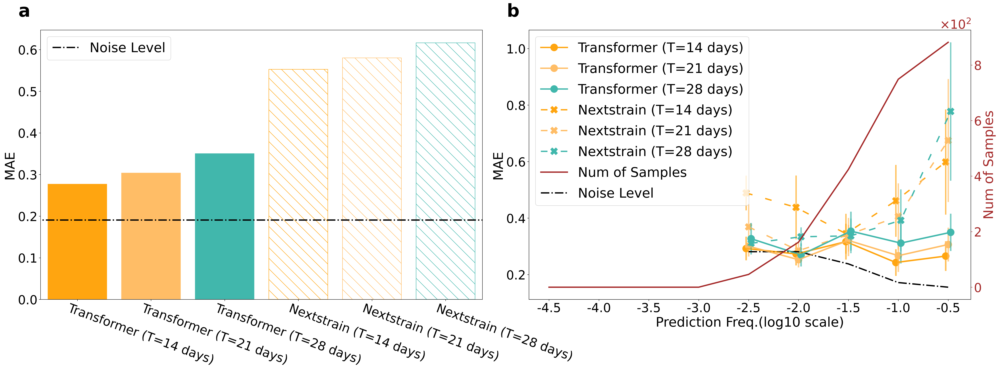

In [ ]:
plot_main_result2_2(pred[:3], true[:3], true_smooth[:3], mlr[:3], raw_clade, smoothed_clade, name_list[:3],
            None, None, None, future_list[:3], colors[:3], line_format[:3], country='', norm=False, split_date='2022-12-31', offset=True)

In [ ]:
nextstrain_base = True

days = 0
d = mlr[days]
day_list = [' (T=14 days)', ' T=21 days)', ' (T=28 days)']

frontsize1 = 20
frontsize2 = 16
frontsize3 = 40

countries_plot = ['USA', 'GBR', 'CHN', 'AUS']
height = 3
weight = len(countries_plot)
fig, ax = plt.subplots(height, weight, figsize=(9*weight, 10.3*height), dpi=300)

total = [0] * weight

for k in d.keys():
  if k[:3] not in countries_plot:
    continue
  flag = False
  for i in range(weight):
    if k[:3] == countries_plot[i] and total[i] >= height:
      flag = True
      break
  if flag:
      continue

  v = d[k]

  if np.isnan(v[1]).all():
    continue

  v[1] = np.clip(v[1],-4,0)

  l = true[days][k]
  p = pred[days][k]

  global_max = np.nanmax(l[0])
  global_min = np.max([global_max-365, np.nanmin(l[0])])

  if nextstrain_base:
    ind = np.where(np.isnan(v[1]) == False)[0]
    l_ind = ind if ind[0]>0 else ind[1:]
    global_min = l[0, l_ind[0]]
  else:
    while True:
      l_ind = np.where(l[0] == global_min)[0]
      if l_ind.shape[0] != 0:
          break
      global_min -= 1
  condition_A = np.sum(np.isnan(v[1, l_ind[0]:]))/ (np.sum(np.isnan(v[1, l_ind[0]:])) + np.sum(~np.isnan(v[1, l_ind[0]:]))) >=0.9
  condition_B = np.sum(~np.isnan(v[1, l_ind[0]:])) < 21
  if condition_A or condition_B:
    continue

  for h in range(weight):
    if k[:3] == countries_plot[h]:
      i, j = total[h], h
      total[h] += 1
      break

  ax[i, j].plot(l[0, l_ind[0]:], l[1, l_ind[0]:], label='Raw data', linewidth=3, color='k')
  ax[i, j].plot(v[0, l_ind[0]:], v[1, l_ind[0]:], label='Nextstrain' + day_list[days], linewidth=3, color='tab:orange')
  ax[i, j].plot(p[0, l_ind[0]:], p[1, l_ind[0]:], label='Transformer' + day_list[days], linewidth=3, color='g')
  ax[i, j].set_title(k, fontsize = frontsize1)
  ax[i, j].legend(fontsize = frontsize1)

  ax[i, j].set_ylim(-3.1, 0.)

  bin_centers = np.arange(global_min, global_max, 30)
  x_labels = [trans_date(d) for d in bin_centers]

  ax[i, j].set_xticks(bin_centers)
  ax[i, j].set_xticklabels(x_labels, ha='left')
  ax[i, j].tick_params(axis='y', labelsize=frontsize2)
  ax[i, j].tick_params(axis='x', labelsize=frontsize2, rotation=-20)

  ax[i, j].set_ylabel('Frequency', fontsize = frontsize1)
  ax[i, j].set_xlabel('Date', fontsize = frontsize1)

  flag = 0
  for i in range(height):
    if total[i] >= weight:
      flag += 1
  if flag == height:
    print('Plot All')
    break

fig.savefig(f'nextstrain_vis.png', bbox_inches='tight', pad_inches=0)
plt.show()
plt.close()

## Download

In [ ]:
# Deep copy the list of dictionaries
mlr = copy.deepcopy(pred)

# Iterate through the copied list and set the first row of each array to NaN
for d in mlr:
    for key in d:
        d[key][1, :] = np.nan

In [ ]:
country_name = {
    'USA': 'USA',
    'Denmark': 'DNK',
    'India': 'IND',
    'Netherlands': 'NLD',
    'Australia': 'AUS',
    'Sweden': 'SWE',
    'Belgium': 'BEL',
    'Slovenia': 'SVN',
    'Russia': 'RUS',
    'Finland': 'FIN',
    'Japan': 'JPN',
    'France': 'FRA',
    'Singapore': 'SGP',
    'United Kingdom': 'GBR',
    'Turkey': 'TUR',
    'hierarchical': None,  # No ISO code for 'hierarchical'
    'Germany': 'DEU',
    'Spain': 'ESP',
    'China': 'CHN',
    'Switzerland': 'CHE',
    'Ireland': 'IRL',
    'South Korea': 'KOR',
    'Israel': 'ISR',
    'Dominican Republic': 'DOM', # not in our data
    'Italy': 'ITA',
    'Poland': 'POL',
    'New Zealand': 'NZL',
    'Portugal': 'PRT',
    'Canada': 'CAN',
    'Malaysia': 'MYS'
}

In [ ]:
cl2 = ['GBR', 'USA', 'IND', 'IRL', 'ISR', 'BEL', 'NLD', 'ITA', 'FRA', 'POL', 'JPN', 'DNK', 'ESP', 'CAN', 'SWE', 'DEU', 'SGP', 'KOR', 'AUS', 'CHN']

not_in, not_in2 = [], []
for k, v in country_name.items():
  if v and v not in cl2:
    not_in.append([k,v])

print(not_in)

for v in not_in:
  if v[1] in country_list:
    not_in2.append(v[0])

print(not_in2)

[['Slovenia', 'SVN'], ['Russia', 'RUS'], ['Finland', 'FIN'], ['Turkey', 'TUR'], ['Switzerland', 'CHE'], ['Dominican Republic', 'DOM'], ['New Zealand', 'NZL'], ['Portugal', 'PRT'], ['Malaysia', 'MYS']]
['Slovenia', 'Russia', 'Finland', 'Turkey', 'Switzerland', 'Dominican Republic', 'New Zealand', 'Portugal', 'Malaysia']


In [ ]:
k0 = max(int(date_min), deal_str_date('2022-12-31')) - 60
k1 = int(date_max - 14)

# country_name = {'United Kingdom': 'GBR', 'USA': 'USA'}
file_path = 'MyDrive/Covid_UK/time_data/plot_result/mlr.pkl'

count = 0
error_name = []
missing_location = []
missing_date = []

check_list = []

none_list = []
none_list2 = []
all_result_log = ['PlaceHolder']*4
for k in range(k0, k1+1):
  access_date = trans_date(k)
  url = f'https://data.nextstrain.org/files/workflows/forecasts-ncov/gisaid/nextstrain_clades/global/mlr/{access_date}_results.json'
  future_ind = np.array(future_list) + k

  response = requests.get(url)
  all_result_log.append(f'Finish {k-k0+1}/{k1-k0+1}, Access date {access_date}, Status: {response.status_code}')

  clear_output(wait=True)
  for i in range(-5,0,1):
    print(all_result_log[i])
  if response.status_code == 200:
      all = json.loads(response.text)
      data_list = all['data']

      site = all['metadata']['sites']
      if 'freq_forecast' not in site:
        none_list2.append(access_date)
        continue

      for data in data_list:
        if data['site']!= 'freq_forecast' or data['ps']!= 'median':
          continue
        if data['location'] not in country_name.keys():
          missing_location.append(data['location'])
          continue
        else:
          location = country_name[data['location']]

        date = deal_str_date(data['date'])
        variant = location + '_' + data['variant']

        if location in not_in2 and date >= future_ind[0] and data['value']>0:
          check_list.append([data, trans_date(int(k)), date-k])

        l_ind = np.where(future_ind == date)[0]
        if l_ind.shape[0] == 0:
            # print(1, l_ind)
            continue

        if variant not in mlr[l_ind[0]].keys():
          error_name.append(variant)
          # print(2, variant)
          continue

        date_ind = np.where(mlr[l_ind[0]][variant][0] == date)[0]
        if date_ind.shape[0] == 0:
            missing_date.append([variant, date])
            # print(3, date_ind)
            continue
        # if date_ind[0] == 0:
        #   print(k, access_date)
        #   print(data)
        #   print(mlr[l_ind[0]][variant][0])
        #   sdfdagdga

        freq = np.log10(data['value'])
        mlr[l_ind[0]][variant][1, date_ind[0]] = np.clip(freq, -4, 0)
        count += 1

        # with open(file_path, 'wb') as file:
        #     pickle.dump(mlr, file)
  else:
      none_list.append(access_date)
  # time.sleep(1)

print(none_list)
print(none_list2)
print(count)
print(list(set(error_name)))
print(list(set(missing_location)))
print(missing_date)
print(len(check_list))

Finish 459/463, Access date 2024-02-02, Status: 200
Finish 460/463, Access date 2024-02-03, Status: 404
Finish 461/463, Access date 2024-02-04, Status: 200
Finish 462/463, Access date 2024-02-05, Status: 200
Finish 463/463, Access date 2024-02-06, Status: 200
['2022-11-01', '2022-11-02', '2022-11-03', '2022-11-04', '2022-11-05', '2022-11-06', '2022-11-07', '2022-11-08', '2022-11-09', '2022-11-10', '2022-11-11', '2022-11-12', '2022-11-13', '2022-11-14', '2022-11-15', '2022-11-16', '2022-11-17', '2022-11-18', '2022-11-19', '2022-11-20', '2022-11-21', '2022-11-22', '2022-11-23', '2022-11-24', '2022-11-25', '2022-11-26', '2022-11-27', '2022-11-28', '2022-11-29', '2022-11-30', '2022-12-01', '2022-12-02', '2022-12-03', '2022-12-04', '2022-12-05', '2022-12-06', '2022-12-07', '2022-12-08', '2022-12-09', '2022-12-10', '2022-12-11', '2022-12-12', '2022-12-13', '2022-12-14', '2022-12-15', '2022-12-16', '2022-12-17', '2022-12-18', '2022-12-19', '2022-12-20', '2022-12-21', '2022-12-22', '2023-01-07

In [ ]:
file_path = 'drive/MyDrive/Covid_UK/time_data/plot_result/mlr_all_country_latest_noise.pkl'
with open(file_path, 'wb') as file:
    pickle.dump(mlr, file)

# Supp. function

In [ ]:
# @title plot_summary
def plot_summary(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, original, smoothed, name_list, inputfreq_dict_list, snr_dict_list, datapoint_dict_list,
            noise_level, noise_ind, noise_ind2, future_list, colors, line_format, country='', norm=False, split_date='2022-12-31', country_list=None):
    key_list_all = set()
    for d in true_dict_list:
        key_list_all.update(d.keys())
    key_list_all = list(key_list_all)

    if country_list:
      for c in country_list:
          key_list = [item for item in key_list_all if country in item]
    else:
      key_list = [item for item in key_list_all if country in item]

    lineage_dict={}
    for k in key_list:
      lineage_dict[k] = [[k],'']

    if norm:
      pred_dict_list, exp_dict_list = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)

    date_list, input_freq_list, pred_list, label_list, slabel_list, exp_date_list, exp_list, snr_list, num_data_list = [], [], [], [], [], [], [], [], []
    aligned_date_list = []
    noise_list = []
    mask_list = []
    model_error_list, model_name_list = [], []
    for i, n in enumerate(name_list):
      date, input_freq, pred, label, slabel, exp_date, exp, snr, num_data = [], [], [], [], [], [], [], [], []
      aligned_date = []

      for k in pred_dict_list[i].keys():
        if country_list and k[:3] not in country_list:
          continue
        elif len(country) and country not in k:
          continue
        date.append(pred_dict_list[i][k][0])
        aligned_date.append(np.arange(pred_dict_list[i][k][0].shape[0]))
        pred.append(pred_dict_list[i][k][1])
        label.append(true_dict_list[i][k][1])
        slabel.append(true_smooth_dict_list[i][k][1])

        exp_date.append(exp_dict_list[i][k][0])
        exp.append(exp_dict_list[i][k][1])

        input_freq.append(inputfreq_dict_list[i][k][1])
        snr.append(snr_dict_list[i][k][1])
        num_data.append(datapoint_dict_list[i][k][1])

      date_list.append(np.concatenate(date))
      aligned_date_list.append(np.concatenate(aligned_date))
      pred_list.append(np.concatenate(pred))
      label_list.append(np.concatenate(label))
      slabel_list.append(np.concatenate(slabel))
      exp_date_list.append(np.concatenate(exp_date))
      exp_list.append(np.concatenate(exp))
      input_freq_list.append(np.concatenate(input_freq))
      snr_list.append(np.concatenate(snr))
      num_data_list.append(np.concatenate(num_data))

      mask_list.append(np.concatenate(num_data)>=14)

      # model_error_list.append(np.abs(np.concatenate(pred)-np.concatenate(label)))
      model_error_list.append(np.concatenate(pred)-np.concatenate(label))
      model_name_list.append(n)
      # model_error_list.append(np.abs(np.concatenate(exp)-np.concatenate(label)))
      # model_error_list.append(np.concatenate(exp)-np.concatenate(label))
      # model_name_list.append(f'Regression_{future_list[i]}D')

      print(n)
      print('date_list: ', date_list[-1].shape)
      print('aligned_date_list: ', aligned_date_list[-1].shape)
      print('pred_list: ', pred_list[-1].shape)
      print('label_list: ', label_list[-1].shape)
      print('slabel_list: ', slabel_list[-1].shape)
      print('exp_date_list: ', exp_date_list[-1].shape)
      print('exp_list: ', exp_list[-1].shape)
      print('input_freq_list: ', input_freq_list[-1].shape)
      print('snr_list: ', snr_list[-1].shape)
      print('num_data_list: ', num_data_list[-1].shape)
      print()


    smooth_date, smooth = [], []
    raw_date, raw = [], []
    for k in key_list:
      if k not in smoothed.keys():
        continue
      smooth_date.append(smoothed[k][:, 0])
      smooth.append(smoothed[k][:, 1])
      raw_date.append(original[k][:, 0])
      raw.append(original[k][:, 1])
    smooth_date = np.concatenate(smooth_date)
    smooth = np.concatenate(smooth)
    raw_date = np.concatenate(raw_date)
    raw = np.concatenate(raw)

    print('smooth_date: ', smooth_date.shape)
    print('smooth: ', smooth.shape)
    print('raw_date: ', raw_date.shape)
    print('raw: ', raw.shape)

    if noise_ind is not None:
      print('noise_ind: ', noise_ind.shape)
      print('noise_level: ', noise_level.shape)

    if split_date:
      split = deal_str_date(split_date)
    else:
      split = None


    ## Date
    # bin_edges = np.arange(1090, 1360, 30)
    # bin_centers = bin_edges[:-1] + 30 / 2
    # x_labels = [trans_date(d) for d in bin_centers]
    # calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, date_list,
    #         pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
    #         noise_ind, noise_level, x_labels, split, f'Time vs. MAE.pdf', 'Time', mask_list)

    ## Aligned_Date
    # bin_edges = np.arange(0, 245, 7)
    # bin_centers = bin_edges[:-1] + 7 / 2
    # x_labels = [int(d//7+1) for d in bin_centers]
    # calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, aligned_date_list,
    #         pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
    #         noise_ind, noise_level, x_labels, split, f'Weeks vs. MAE.pdf', 'Weeks', mask_list)

    ## Input
    bin_edges = np.arange(-4.75, 0.25, 0.5)
    bin_centers = bin_edges[:-1] + 0.5 / 2
    # # x_labels = ["{:.2f}".format(np.power(10,d)) for d in bin_centers]
    x_labels = None
    # calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, input_freq_list,
    #         pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
    #         noise_ind2, noise_level, x_labels, split, f'Input Freq. vs. MAE.pdf', 'Input Freq.(log10 scale)', mask_list)

    ## Label
    calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, label_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind2, noise_level, x_labels, split, f'Target Freq. vs. MAE.pdf', 'Target Freq.(log10 scale)', mask_list)

    ## Pred
    calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, pred_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind2, noise_level, x_labels, split, f'Prediction Freq. vs. MAE.pdf', 'Prediction Freq.(log10 scale)', mask_list)


    ## Snr
    bin_edges = np.arange(-15, 45, 10)
    bin_centers = bin_edges[:-1] + 5
    calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, snr_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, None, split, f'SNR vs. MAE.pdf', 'SNR', mask_list)

    ## Num_datapoints
    bin_edges = np.arange(0, 49, 7)
    bin_centers = bin_edges[:-1] + 3.5
    calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, num_data_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, None, split, f'#Valid Data vs. MAE.pdf', '#Valid Data', None)

    ## Boxplot
    # fig, ax = plt.subplots(figsize=(24, 6))
    # ax.boxplot(model_error_list)
    # ax.set_xticks(np.arange(len(model_name_list)) + 1)
    # ax.set_xticklabels(model_name_list)

    # ax.set_title('Model Errors')
    # ax.set_ylabel('MAE')
    # ax.set_xlabel('Model Names')
    # fig.savefig('Boxplot.pdf')
    # plt.show()
    # plt.close()

    ## Barplot
    mean_error_list, mean_name_list, color_list, fill_list, style_list = [], [], [], [], []
    for i, n in enumerate(model_name_list):
      if 'Regression' not in model_name_list[i]:
        mean_error_list.append(np.mean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i])
        fill_list.append(colors[i])
        style_list.append(None)
    # for i, n in enumerate(model_name_list):
    #   if 'Regression' in model_name_list[i]:
    #     mean_error_list.append(np.mean(np.abs(model_error_list[i])))
    #     mean_name_list.append(model_name_list[i])
    #     color_list.append(colors[i//2])
    #     fill_list.append('none')
    #     style_list.append('\\')

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    true = label_list[0]
    strue = slabel_list[0]
    mean_noise = np.mean(np.abs(strue - true))

    fig, ax = plt.subplots(figsize=(12, 8), dpi=300)
    bars = ax.bar(x, mean_error_list, edgecolor=color_list)
    for i, bar in enumerate(bars):
      bar.set_facecolor(fill_list[i])
      bar.set_hatch(style_list[i])

    ax.set_xticks(np.arange(len(mean_name_list)))
    ll = ax.set_xticklabels(mean_name_list, fontsize = 14, ha='center') #, rotation=-20, ha='left'
    # trans = mtransforms.ScaledTranslation(-25/72., 0, fig.dpi_scale_trans) # 5 points to the left
    # # Apply the transformation to each label
    # for label in ll:
    #     label.set_transform(label.get_transform() + trans)

    ax.tick_params(axis='y', labelsize=14)

    ax.hlines(mean_noise, -1, len(mean_name_list), colors='k', linestyles='dotted', label='Noise Level')

    ax.set_title('Model Errors', fontsize = 16)
    ax.set_ylabel('MAE', fontsize = 16)
    ax.set_xlabel('Model Names', fontsize = 16)
    ax.set_xlim(-0.5, len(mean_name_list)-0.5)
    plt.legend(fontsize = 14)
    fig.savefig('Barplot.pdf')
    plt.show()
    plt.close()

In [ ]:
# @title main_subplots
def main_subplots(ax1_1, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, index_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, split_end, name, x_name, mask_list, frontsize1, frontsize2, offset=False, plot_samples=True):

  if plot_samples:
    ax1_2 = ax1_1.twinx()
  line1 = []

  base_offset = (bin_centers[1] - bin_centers[0])/offset if offset else 0
  capsize = 0

  print()
  print('==========')
  print('main_subplots')
  print(name)
  print(x_name)

  for i in range(len(name_list)):
    k = i - len(name_list)/2 + 0.5
    line_name = name_list[i]
    line_color = colors[i]
    lf = line_format[i]
    future = future_list[i]

    index = index_list[i]
    date = date_list[i]
    pred = pred_list[i]
    true = label_list[i]
    strue = slabel_list[i]
    mae = np.abs(pred - true)
    noise = np.abs(strue - true)

    exp_date = exp_date_list[i]
    exp = exp_list[i]
    # exp_new = np.full(date.shape, np.nan)
    # indices = np.isin(date, exp_date)
    # exp_new[indices] = exp[np.searchsorted(exp_date, date[indices])]
    exp_mae = np.abs(exp - true)

    if mask_list:
      m = mask_list[i]
      print('aaaa', i)
      print(np.sum(m))
      print(index.shape)

      date = date[m]
      mae = mae[m]
      exp_mae = exp_mae[m]
      exp = exp[m]
      index = index[m]
      print(index.shape)

    if split:
      time_mask = date >= split

      mae = mae[time_mask]
      exp_mae = exp_mae[time_mask]
      exp = exp[time_mask]
      index = index[time_mask]
    if split_end:
      time_mask = date <= split

      mae = mae[time_mask]
      exp_mae = exp_mae[time_mask]
      exp = exp[time_mask]
      index = index[time_mask]

    errors, variances =  bin_error(bin_centers, bin_edges, index, mae)
    print(line_name, errors)
    lw = 2
    if line_name == 'Original':
      lw = 4
    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centers + k*base_offset, errors, lf, label=line_name, color=line_color, ms=16, linewidth=lw)
      ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='-',
                      color=line_color, alpha=0.7, ms=16, capsize=capsize, linewidth=lw+0.5)
      line1 += l
    else:
      # l = ax1_1.plot(bin_centers[2:]+ k*base_offset, errors[2:], lf, label=line_name, color=line_color, ms=16, linewidth=lw)
      # ax1_1.errorbar(bin_centers+ k*base_offset, errors, yerr=variances, fmt=lf,
      #                 color=line_color, alpha=0.2, ms=16, linewidth=lw+0.5, capsize=capsize)
      # line1 += l

      # ax1_1.plot(bin_centers[:2]+ k*base_offset, errors[:2], lf, color=line_color, alpha=0.2, ms=16, linewidth=lw)
      # ax1_1.errorbar(bin_centers+ k*base_offset, errors, yerr=variances, fmt=lf,
      #                 color=line_color, alpha=0.1, ms=16, linewidth=lw+0.5, capsize=capsize)

      l = ax1_1.plot(bin_centers+ k*base_offset, errors, lf, label=line_name, color=line_color, ms=16, linewidth=lw)
      ax1_1.errorbar(bin_centers+ k*base_offset, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.2, ms=16, linewidth=lw+0.5, capsize=capsize)
      line1 += l


    if 'Prediction' not in name:
      errors, variances =  bin_error(bin_centers, bin_edges, index, exp_mae)
    else:
      errors, variances =  bin_error(bin_centers, bin_edges, exp, exp_mae)

    # if '#Valid Data' not in name:
    #   l = ax1_1.plot(bin_centers + k*base_offset, errors, linestyle=(0, (5, 10)), marker='X', label=f'Regression (T={future} days)', color=line_color, ms=16, linewidth=3)
    #   ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, linestyle=(0, (5, 10)),
    #                   color=line_color, alpha=0.7, ms=10, capsize=capsize, linewidth=3)
    #   line1 += l
    # else:
    #   pass
      # l = ax1_1.plot(bin_centers[2:] + k*base_offset, errors[2:], '--o', label=f'Regression_{future}', color=line_color)
      # ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.2)
      # line1 += l

      # ax1_1.plot(bin_centers[:2] + k*base_offset, errors[:2], '--o', color=line_color, alpha=0.2)
      # ax1_1.errorbar(bin_centers + k*base_offset, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.1)

  if 'SNR' not in name and '#Valid Data' not in name:
    # noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, noise_ind, noise_level, num_samples=True)
    index = index_list[0][mask_list[0]]
    true = label_list[0][mask_list[0]]
    strue = slabel_list[0][mask_list[0]]
    print(index.shape)
    noise = np.abs(strue - true)
    noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, index, noise, num_samples=True)

    l = ax1_1.plot(bin_centers, noise_level, linestyle='dashdot', label='Noise Level', color='k', ms=10, linewidth=3)
    line1 += l
    if plot_samples:
      l = ax1_2.plot(bin_centers, num_samples, '-', label='Num of Samples', color='brown', linewidth=3)
      print(np.sum(num_samples))
      line1 += l


  # labels = [l.get_label() for l in line1]
  # zipped_lists = list(zip(line1, labels))
  # sorted_pairs = sorted(zipped_lists, key=lambda x: x[1])
  # if '#Valid Data' not in name:
  #     ind = len(sorted_pairs)//2 - 1
  #     sorted_pairs = sorted_pairs[2+ind:] + sorted_pairs[1:2] + sorted_pairs[2:2+ind] + sorted_pairs[0:1]
  # line1_sorted, labels_sorted = zip(*sorted_pairs)

  # ax1_1.legend(line1_sorted, labels_sorted, fontsize = 14, ncol=2)

  if x_labels:
    if 'Weeks' in name:
      ax1_1.set_xticks(bin_centers[::2])
      ax1_1.set_xticklabels(x_labels[::2])
    else:
      ax1_1.set_xticks(bin_centers)
      ax1_1.set_xticklabels(x_labels)
  ax1_1.tick_params(axis='y', labelsize=frontsize2)
  ax1_1.tick_params(axis='x', labelsize=frontsize2)
  # ax1_1.set_title(name[:-4], fontsize = frontsize1)
  ax1_1.set_ylabel('MAE', fontsize = frontsize1)

  if plot_samples:
    formatter = ticker.ScalarFormatter(useMathText=True)
    formatter.set_scientific(True)
    formatter.set_powerlimits((-1,1))
    ax1_2.yaxis.set_major_formatter(formatter)
    ax1_2.yaxis.offsetText.set_fontsize(frontsize2)
    ax1_2.tick_params(axis='y', labelsize=frontsize2)
    ax1_2.set_ylabel('Num of Samples', fontsize = frontsize1)
    ax1_2.yaxis.label.set_color('brown')
    ax1_2.tick_params(colors='brown', which='both')

  ax1_1.set_xlabel(x_name, fontsize = frontsize1)

  labels = [l.get_label() for l in line1]
  return line1, labels

In [ ]:
# @title plot_main_result
def plot_main_result(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, original, smoothed, name_list, inputfreq_dict_list, snr_dict_list, datapoint_dict_list,
            noise_level, noise_ind, noise_ind2, future_list, colors, line_format, country_list=['GBR', 'USA'], norm=False, split_date='2022-12-31', split_date2=None, split_date_end='2023-12-31', offset=False):
    split_date2 = split_date if split_date2 is None else split_date2

    key_list_all = set()
    for d in true_dict_list:
        key_list_all.update(d.keys())
    key_list_all = list(key_list_all)

    if norm:
      pred_dict_list_normed = [{} for _ in range(len(pred_dict_list))]
      exp_dict_list_normed = [{} for _ in range(len(exp_dict_list))]
      if not country_list:
        liter_list = [item[:3] for item in key_list_all]
        liter_list = set(liter_list)
        liter_list = list(liter_list)
      else:
        liter_list = country_list
      for country in liter_list:
          key_list = [item for item in key_list_all if country in item]

          lineage_dict = {}
          for k in key_list:
              lineage_dict[k] = [[k], '']

          if norm:
              pln, eln = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)
              for i in range(len(pred_dict_list)):
                pred_dict_list_normed[i].update(pln[i])
                exp_dict_list_normed[i].update(eln[i])

      del pred_dict_list
      pred_dict_list = pred_dict_list_normed
      del exp_dict_list
      exp_dict_list = exp_dict_list_normed

    if country_list:
      key_list = [item for item in key_list_all if item[:3] in country_list]
    else:
      key_list = key_list_all

    # lineage_dict={}
    # for k in key_list:
    #   lineage_dict[k] = [[k],'']

    # if norm:
    #   pred_dict_list, exp_dict_list = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)

    date_list, input_freq_list, pred_list, label_list, slabel_list, exp_date_list, exp_list, snr_list, num_data_list = [], [], [], [], [], [], [], [], []
    aligned_date_list = []
    noise_list = []
    mask_list = []
    model_error_list, model_name_list = [], []
    for i, n in enumerate(name_list):
      date, input_freq, pred, label, slabel, exp_date, exp, snr, num_data = [], [], [], [], [], [], [], [], []
      aligned_date = []
      time_mask = []

      for k in pred_dict_list[i].keys():
        if country_list and k[:3] not in country_list:
          continue
        date.append(pred_dict_list[i][k][0])
        aligned_date.append(np.arange(pred_dict_list[i][k][0].shape[0]))
        pred.append(pred_dict_list[i][k][1])
        label.append(true_dict_list[i][k][1])
        slabel.append(true_smooth_dict_list[i][k][1])

        exp_date.append(exp_dict_list[i][k][0])
        exp.append(exp_dict_list[i][k][1])

        input_freq.append(inputfreq_dict_list[i][k][1])
        snr.append(snr_dict_list[i][k][1])
        num_data.append(datapoint_dict_list[i][k][1])

        if k[3:] in ['GBR', 'USA']:
          sp = deal_str_date(split_date2)
        else:
          sp = deal_str_date(split_date)
        spe = deal_str_date(split_date_end)
        time_mask.append(np.logical_and(pred_dict_list[i][k][0] >= sp, pred_dict_list[i][k][0] <= spe))

      date_list.append(np.concatenate(date))
      aligned_date_list.append(np.concatenate(aligned_date))
      pred_list.append(np.concatenate(pred))
      label_list.append(np.concatenate(label))
      slabel_list.append(np.concatenate(slabel))
      exp_date_list.append(np.concatenate(exp_date))
      exp_list.append(np.concatenate(exp))
      input_freq_list.append(np.concatenate(input_freq))
      snr_list.append(np.concatenate(snr))
      num_data_list.append(np.concatenate(num_data))

      mask_list.append(np.logical_and(np.concatenate(num_data)>=14, np.concatenate(time_mask)))

      # model_error_list.append(np.abs(np.concatenate(pred)-np.concatenate(label)))
      model_error_list.append(np.concatenate(pred)-np.concatenate(label))
      model_name_list.append(n)
      # model_error_list.append(np.abs(np.concatenate(exp)-np.concatenate(label)))
      # model_error_list.append(np.concatenate(exp)-np.concatenate(label))
      # model_name_list.append(f'Regression (T={future_list[i]} days)')

      print(i)
      print(pred_list[-1].shape)
      print(date_list[-1].shape)
      print(date_list[-1][:20])
      print(np.concatenate(time_mask)[:20])
      print(np.sum(np.concatenate(time_mask)))
      print(np.sum(mask_list[-1]))
      print(sp)
      print()


    smooth_date, smooth = [], []
    raw_date, raw = [], []
    for k in key_list:
      if k not in smoothed.keys():
        continue
      smooth_date.append(smoothed[k][:, 0])
      smooth.append(smoothed[k][:, 1])
      raw_date.append(original[k][:, 0])
      raw.append(original[k][:, 1])
    smooth_date = np.concatenate(smooth_date)
    smooth = np.concatenate(smooth)
    raw_date = np.concatenate(raw_date)
    raw = np.concatenate(raw)

    # if split_date:
    #   split = deal_str_date(split_date)
    # else:
    #   split = None
    # if split_date_end:
    #   split_end = deal_str_date(split_date_end)
    # else:
    #   split_end = None

    split = None
    split_end = None

    height = 22
    weight = 22*1.715
    fig = plt.figure(figsize=(weight, height), dpi=300)

    gs = GridSpec(2, 6, figure=fig)
    axA = fig.add_subplot(gs[0, :3])
    axB = fig.add_subplot(gs[0, 3:])
    axC = fig.add_subplot(gs[1:, :3])
    axLegend = fig.add_subplot(gs[1, 3:])

    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 40

    #wspace=0.4, hspace=0.4, ncol=1, labelspacing=0.5, frontsize=[30,28,30]


    ## Aligned_Date
    # bin_edges = np.arange(0, 245, 7)
    # bin_centers = bin_edges[:-1] + 7 / 2
    # x_labels = [int(d//7+1) for d in bin_centers]
    # bin_edges = np.arange(0, 147, 7)
    # bin_centers = bin_edges[:-1] + 7 / 2
    # x_labels = [int(d//7+1) for d in bin_centers]

    # bin_edges = np.concatenate([bin_edges, np.array([238])])
    # bin_centers = bin_edges[:-1] + 7 / 2
    # x_labels += ['20+']
    # offset_value = 10 if offset else False
    # handles1, labels1 = main_subplots(axC, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, aligned_date_list,
    #         pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
    #         noise_ind, noise_level, x_labels, split, split_end, f'Weeks vs. MAE.png', 'Weeks', mask_list, frontsize1, frontsize2, offset=offset_value, plot_samples=False)

    ## Num_datapoints
    bin_edges = np.arange(14, 49, 7)
    bin_edges[-1] += 1
    bin_centers = bin_edges[:-1] + 3.5
    x_labels = ['14-20', '21-27', '28-34', '35-42'] #'0-6', '7-13',
    offset_value = False
    main_subplots(axC, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, num_data_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, split_end, f'#Valid Data vs. MAE.pdf', '#Valid Dataponits', None, frontsize1, frontsize2, offset=offset_value, plot_samples=False)

    ## Pred
    bin_edges = np.arange(-4.75, 0.25, 0.5)
    bin_centers = bin_edges[:-1] + 0.5 / 2
    x_labels = ["{:.1f}".format(d) for d in bin_centers]  # ["{:.2f}".format(np.power(10,d)) for d in bin_centers]
    offset_value = 20 if offset else False
    handles2, labels2 = main_subplots(axB, bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, pred_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind2, noise_level, x_labels, split, split_end, f'Prediction Freq. vs. MAE.png', 'Prediction Freq.(log10 scale)', mask_list, frontsize1, frontsize2, offset=offset_value)

    ## Barplot
    mean_error_list, mean_name_list, color_list, fill_list, style_list = [], [], [], [], []
    for i, n in enumerate(model_name_list):
      if 'Regression' not in model_name_list[i]:
        mean_error_list.append(np.mean(np.abs(model_error_list[i])))
        mean_name_list.append(model_name_list[i])
        color_list.append(colors[i])
        fill_list.append(colors[i])
        style_list.append(None)

    mean_error_list = np.array(mean_error_list)
    x = np.arange(len(mean_error_list))

    true = label_list[0]
    strue = slabel_list[0]
    mask = mask_list[0]
    true = true[mask]
    strue = strue[mask]
    mean_noise = np.mean(np.abs(strue - true))

    bars = axA.bar(x, mean_error_list, edgecolor=color_list)
    for i, bar in enumerate(bars):
      bar.set_facecolor(fill_list[i])
      bar.set_hatch(style_list[i])
    print(mean_name_list)
    print(mean_error_list)

    axA.set_xticks(np.arange(len(mean_name_list)))
    ll = axA.set_xticklabels(mean_name_list, fontsize = frontsize2, rotation=-20, ha='left')
    trans = mtransforms.ScaledTranslation(-25/72., 0, fig.dpi_scale_trans) # 5 points to the left
    # Apply the transformation to each label
    for label in ll:
        label.set_transform(label.get_transform() + trans)

    axA.tick_params(axis='y', labelsize=frontsize2)

    axA.hlines(mean_noise, -1, len(mean_name_list), colors='k', linestyles='dashdot', label='Noise Level', linewidth=3)

    # axA.set_title('Model Errors', fontsize = frontsize1)
    axA.set_ylabel('MAE', fontsize = frontsize1)
    # axA.set_xlabel('Model Names', fontsize = frontsize1)
    axA.set_xlim(-0.5, len(mean_name_list)-0.5)
    axA.set_ylim(0, 0.6)
    axA.legend(fontsize = frontsize1)


    h, w = -0.05, 1.1
    axA.text(h, w, 'a', transform=axA.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    axB.text(h, w, 'b', transform=axB.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')
    axC.text(h, w, 'c', transform=axC.transAxes, fontsize=frontsize3, verticalalignment='top', weight='bold')

    # handles1, labels1 = axB.get_legend_handles_labels()
    # handles2, labels2 = axC.get_legend_handles_labels()
    all_handles = handles2 # + handles2
    all_labels = labels2 # + labels2

    unique_labels, unique_handles = all_labels, all_handles

    axLegend.axis('off')
    axLegend.legend(unique_handles, unique_labels, loc='center', fontsize = frontsize1, ncol=1, labelspacing=0.9, frameon=False)

    # plt.tight_layout(pad=0.01)
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.4, hspace=0.4)

    suff = '_norm' if norm else ''
    fig.savefig(f'main_results{suff}_supp.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [ ]:
# @title calculate_plot_bins
def calculate_plot_bins(bin_edges, bin_centers, name_list, colors, line_format, future_list, date_list, index_list,
            pred_list, label_list, exp_date_list, exp_list, bin_error, smooth, raw, slabel_list,
            noise_ind, noise_level, x_labels, split, name, x_name, mask_list):

  if 'Weeks' in name:
    fig1, ax1_1 = plt.subplots(figsize=(24, 6), dpi=300)
  else:
    fig1, ax1_1 = plt.subplots(figsize=(12, 6), dpi=300)
  ax1_2 = ax1_1.twinx()
  line1 = []

  for i in range(len(name_list)):
    line_name = name_list[i]
    line_color = colors[i]
    lf = line_format[i]
    future = future_list[i]

    index = index_list[i]
    date = date_list[i]
    pred = pred_list[i]
    true = label_list[i]
    strue = slabel_list[i]
    mae = np.abs(pred - true)
    noise = np.abs(strue - true)

    exp_date = exp_date_list[i]
    exp = exp_list[i]
    # exp_new = np.full(date.shape, np.nan)
    # indices = np.isin(date, exp_date)
    # exp_new[indices] = exp[np.searchsorted(exp_date, date[indices])]
    exp_mae = np.abs(exp - true)

    if mask_list:
      m = mask_list[i]

      date = date[m]
      mae = mae[m]
      exp_mae = exp_mae[m]
      exp = exp[m]
      index = index[m]

    if split:
      time_mask = date >= split

      mae = mae[time_mask]
      exp_mae = exp_mae[time_mask]
      exp = exp[time_mask]
      index = index[time_mask]

    errors, variances =  bin_error(bin_centers, bin_edges, index, mae)
    if '#Valid Data' not in name:
      l = ax1_1.plot(bin_centers, errors, lf, label=line_name, color=line_color)
      ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.2)
      line1 += l
    else:
      l = ax1_1.plot(bin_centers[2:], errors[2:], lf, label=line_name, color=line_color)
      ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.2)
      line1 += l

      ax1_1.plot(bin_centers[:2], errors[:2], lf, color=line_color, alpha=0.2)
      ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt=lf,
                      color=line_color, alpha=0.1)

    # if 'Prediction' not in name:
    #   errors, variances =  bin_error(bin_centers, bin_edges, index, exp_mae)
    # else:
    #   errors, variances =  bin_error(bin_centers, bin_edges, exp, exp_mae)

    # if '#Valid Data' not in name:
    #   l = ax1_1.plot(bin_centers, errors, '--o', label=f'Regression_{future}D', color=line_color)
    #   ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt='--o',
    #                   color=line_color, alpha=0.2)
    #   line1 += l
    # else:
    #   pass
      # l = ax1_1.plot(bin_centers[2:], errors[2:], '--o', label=f'Regression_{future}', color=line_color)
      # ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.2)
      # line1 += l

      # ax1_1.plot(bin_centers[:2], errors[:2], '--o', color=line_color, alpha=0.2)
      # ax1_1.errorbar(bin_centers, errors, yerr=variances, fmt='--o',
      #                 color=line_color, alpha=0.1)

  # if 'SNR' not in name and '#Valid Data' not in name:
  #   # noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, noise_ind, noise_level, num_samples=True)
  #   index = index_list[0]
  #   true = label_list[0]
  #   strue = slabel_list[0]
  #   noise = np.abs(strue - true)
  #   noise_level, _, num_samples =  bin_error(bin_centers, bin_edges, index, noise, num_samples=True)

  #   l = ax1_1.plot(bin_centers, noise_level, '--', label='Noise Level', color='k')
  #   line1 += l
  #   l = ax1_2.plot(bin_centers, num_samples, '-', label='Num Samples', color='k')
  #   line1 += l


  labels = [l.get_label() for l in line1]
  zipped_lists = list(zip(line1, labels))
  sorted_pairs = zipped_lists # sorted(zipped_lists, key=lambda x: x[1])
  # if '#Valid Data' not in name:
  #     ind = len(sorted_pairs)//2 - 1
  #     sorted_pairs = sorted_pairs[2+ind:] + sorted_pairs[1:2] + sorted_pairs[2:2+ind] + sorted_pairs[0:1]
  line1_sorted, labels_sorted = zip(*sorted_pairs)

  ax1_1.legend(line1, labels, fontsize = 14, ncol=1)

  # ax1_1.legend(line1, labels)
  if x_labels:
    ax1_1.set_xticks(bin_centers)
    ax1_1.set_xticklabels(x_labels)
  ax1_1.tick_params(axis='y', labelsize=14)
  ax1_1.tick_params(axis='x', labelsize=14)
  ax1_1.set_title(name[:-4], fontsize = 16)
  ax1_1.set_ylabel('MAE', fontsize = 16)
  ax1_1.set_xlabel(x_name, fontsize = 16)
  fig1.savefig(name)
  plt.show()
  plt.close()

In [ ]:
# @title plot_scatter
def plot_scatter(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, original, smoothed, name_list, inputfreq_dict_list, snr_dict_list, datapoint_dict_list,
            noise_level, noise_ind, noise_ind2, future_list, colors, line_format, country='', norm=False, split_date='2022-12-31', country_list=None):
    key_list_all = set()
    for d in true_dict_list:
        key_list_all.update(d.keys())
    key_list_all = list(key_list_all)

    if country_list:
      for c in country_list:
          key_list = [item for item in key_list_all if country in item]
    else:
      key_list = [item for item in key_list_all if country in item]

    lineage_dict={}
    for k in key_list:
      lineage_dict[k] = [[k],'']

    if norm:
      pred_dict_list, exp_dict_list = norm_the_result(pred_dict_list, exp_dict_list, lineage_dict)

    date_list, input_freq_list, pred_list, label_list, slabel_list, exp_date_list, exp_list, snr_list, num_data_list = [], [], [], [], [], [], [], [], []
    aligned_date_list = []
    noise_list = []
    mask_list = []
    model_error_list, model_name_list = [], []
    for i, n in enumerate(name_list):
      date, input_freq, pred, label, slabel, exp_date, exp, snr, num_data = [], [], [], [], [], [], [], [], []
      aligned_date = []

      for k in pred_dict_list[i].keys():
        if country_list and k[:3] not in country_list:
          continue
        date.append(pred_dict_list[i][k][0])
        aligned_date.append(np.arange(pred_dict_list[i][k][0].shape[0]))
        pred.append(pred_dict_list[i][k][1])
        label.append(true_dict_list[i][k][1])
        slabel.append(true_smooth_dict_list[i][k][1])

        exp_date.append(exp_dict_list[i][k][0])
        exp.append(exp_dict_list[i][k][1])

        input_freq.append(inputfreq_dict_list[i][k][1])
        snr.append(snr_dict_list[i][k][1])
        num_data.append(datapoint_dict_list[i][k][1])

      date_list.append(np.concatenate(date))
      aligned_date_list.append(np.concatenate(aligned_date))
      pred_list.append(np.concatenate(pred))
      label_list.append(np.concatenate(label))
      slabel_list.append(np.concatenate(slabel))
      exp_date_list.append(np.concatenate(exp_date))
      exp_list.append(np.concatenate(exp))
      input_freq_list.append(np.concatenate(input_freq))
      snr_list.append(np.concatenate(snr))
      num_data_list.append(np.concatenate(num_data))

      mask_list.append(np.concatenate(num_data)>=14)

      # model_error_list.append(np.abs(np.concatenate(pred)-np.concatenate(label)))
      model_error_list.append(np.concatenate(pred)-np.concatenate(label))
      model_name_list.append(n)
      # model_error_list.append(np.abs(np.concatenate(exp)-np.concatenate(label)))
      # model_error_list.append(np.concatenate(exp)-np.concatenate(label))
      # model_name_list.append(f'Regression_{future_list[i]}D')

      print(n)
      print('date_list: ', date_list[-1].shape)
      print('aligned_date_list: ', aligned_date_list[-1].shape)
      print('pred_list: ', pred_list[-1].shape)
      print('label_list: ', label_list[-1].shape)
      print('slabel_list: ', slabel_list[-1].shape)
      print('exp_date_list: ', exp_date_list[-1].shape)
      print('exp_list: ', exp_list[-1].shape)
      print('input_freq_list: ', input_freq_list[-1].shape)
      print('snr_list: ', snr_list[-1].shape)
      print('num_data_list: ', num_data_list[-1].shape)
      print()


    smooth_date, smooth = [], []
    raw_date, raw = [], []
    for k in key_list:
      smooth_date.append(smoothed[k][:, 0])
      smooth.append(smoothed[k][:, 1])
      raw_date.append(original[k][:, 0])
      raw.append(original[k][:, 1])
    smooth_date = np.concatenate(smooth_date)
    smooth = np.concatenate(smooth)
    raw_date = np.concatenate(raw_date)
    raw = np.concatenate(raw)

    print('smooth_date: ', smooth_date.shape)
    print('smooth: ', smooth.shape)
    print('raw_date: ', raw_date.shape)
    print('raw: ', raw.shape)

    print('noise_ind: ', noise_ind.shape)
    print('noise_level: ', noise_level.shape)

    if split_date:
      split = deal_str_date(split_date)
    else:
      split = None

    ## Scatter
    k = len(model_name_list)
    fig, ax = plt.subplots(1, k, figsize=(k*10, 10), dpi=300)
    frontsize1 = 30
    frontsize2 = 28
    frontsize3 = 40
    for i, n in enumerate(name_list):
      true = label_list[i][::10]
      pred = pred_list[i][::10]

      xy = np.vstack([true, pred])
      z = gaussian_kde(xy)(xy)
      idx = z.argsort()
      true, pred, z = true[idx], pred[idx], z[idx]
      v = np.clip(z * 6, 0.025, 1)
      ax[i].scatter(true, pred, c=z, edgecolor=None, alpha=v)
      ax[i].set_ylabel(f'{n}', fontsize=frontsize1)

      # corr_coef, p_value = stats.pearsonr(pred_list[i], label_list[i], alternative='greater')
      # print(n)
      # print(f"Pearson Correlation Coefficient: {corr_coef:.2f}")
      # print(f"P-value: {p_value:.4}")

      # true = label_list[i]
      # exp_pred = exp_list[i]

      # xy = np.vstack([true, exp_pred])
      # z = gaussian_kde(xy)(xy)
      # idx = z.argsort()
      # true, exp_pred, z = true[idx], exp_pred[idx], z[idx]
      # v = np.clip(z * 1.2, 0.025, 1)
      # ax[1, i].scatter(true, exp_pred, c=z, edgecolor=None, alpha=v)
      # ax[1, i].set_ylabel(f'Regression_{future_list[i]}D', fontsize=frontsize1)

    min_list, max_list = [], []
    for i in range(k):
        x_min, x_max = ax[i].get_xlim()
        y_min, y_max = ax[i].get_ylim()
        min_list += [x_min, y_min]
        max_list += [x_max, y_max]

    lims = [np.min(np.array(min_list)) - 0.1, np.max(np.array(max_list)) + 0.1]
    for i in range(k):
        ax[i].plot(lims, lims, 'k-', alpha=0.75, zorder=0)
        ax[i].set_aspect('equal')
        ax[i].set_xlim(lims)
        ax[i].set_ylim(lims)
        ax[i].set_xlabel('Target', fontsize=frontsize1)
        ax[i].tick_params(axis='y', labelsize=frontsize2)
        ax[i].tick_params(axis='x', labelsize=frontsize2)

    fig.suptitle('Target vs. Prediction', fontsize = frontsize1)
    fig.savefig('Scatter.pdf')
    plt.show()
    plt.close()

# Run_supp

In [ ]:
filename = 'drive/MyDrive/Covid_UK/time_data/plot_result/all_results_best_14_ablation_latest2_noise.pkl.gz'
result = load_all(filename)

In [ ]:
for k, v in result.items():
    globals()[k] = v

In [ ]:
future_list

[14, 14, 14, 14, 14, 14, 14, 14, 14]

In [ ]:
name_list

['Transformer_14D',
 'Transformer_14D',
 'Transformer_14D',
 'Transformer_14D',
 'Transformer_14D',
 'Transformer_14D',
 'Transformer_14D',
 'Transformer_14D',
 'Transformer_14D']

In [ ]:
original_colors = [c for c in colors]

colors = ["tab:orange","dodgerblue", "blueviolet", "green"]

name_list = ['Original',
 'No Weighted Loss',
 'Trained with Raw Data',
 '2 Layer Transformer']

In [ ]:
pred_dict_list = [pred_dict_list[0], pred_dict_list[3], pred_dict_list[4], pred_dict_list[5]]

In [ ]:
_, GBR_raw_dict, _, _, _, _, GBR_smoothed_dict_test, _, GBR_noise_level, GBR_noise_ind, GBR_noise_ind2 = load_label_smooth2('drive/MyDrive/Covid_UK/time_data/collect_date_v4/Freqs_byCountry', 'GBR', output_noise_level=True)
_, USA_raw_dict, _, _, _, _, USA_smoothed_dict_test, _, USA_noise_level, USA_noise_ind, USA_noise_ind2 = load_label_smooth2('drive/MyDrive/Covid_UK/time_data/collect_date_v4/Freqs_byCountry', 'USA', output_noise_level=True)

2020-01-29
GBR  Label Has 2126 Missing
85
GBR  1024 Removed
1288
2020-01-04
USA  Label Has 2422 Missing
71
USA  878 Removed
1678


In [ ]:
GBR_save_path = 'GBR/'
USA_save_path = 'USA/'

In [ ]:
plot_main_result(pred_dict_list, true_dict_list, true_smooth_dict_list, exp_dict_list, raw, smoothed, name_list, inputfreq_dict_list, snr_dict_list, datapoint_dict_list,
            GBR_noise_level, GBR_noise_ind, GBR_noise_ind2, future_list, colors, line_format, norm=False, split_date='2022-12-31', split_date_end='2024-12-31', country_list=None, offset=True)

0
(436212,)
(436212,)
[1118.  590.  591.  592.  593.  594.  595.  596.  597.  598.  599.  600.
  601.  602.  603.  604.  605.  606.  608.  609.]
[ True False False False False False False False False False False False
 False False False False False False False False]
150051
99098
1095

1
(436212,)
(436212,)
[1118.  590.  591.  592.  593.  594.  595.  596.  597.  598.  599.  600.
  601.  602.  603.  604.  605.  606.  608.  609.]
[ True False False False False False False False False False False False
 False False False False False False False False]
150051
99098
1095

2
(436212,)
(436212,)
[1118.  590.  591.  592.  593.  594.  595.  596.  597.  598.  599.  600.
  601.  602.  603.  604.  605.  606.  608.  609.]
[ True False False False False False False False False False False False
 False False False False False False False False]
150051
99098
1095

3
(436212,)
(436212,)
[1118.  590.  591.  592.  593.  594.  595.  596.  597.  598.  599.  600.
  601.  602.  603.  604.  605.  606.  608.  